## Fit a "Regional Grain Size Model" to SouthEast USA, E Australia, and S CA samples

Daniel Buscombe, Sept 2022

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

from sklearn.model_selection import train_test_split
from sklearn import ensemble
from sklearn.metrics import mean_squared_error
from sklearn.inspection import permutation_importance

from pingouin import partial_corr
import pingouin as pg
from sklearn.model_selection import RepeatedKFold, cross_val_score
import seaborn as sns
from sklearn import preprocessing
from sklearn.model_selection import GridSearchCV

import geopandas as gpd
from geopandas.tools import sjoin

In [2]:
do_gs_strat = True

In [3]:
if do_gs_strat:

    df = pd.read_csv('../model_data/dataset_SEUS_EAus_SCA_strat-by-gs.csv')


rand = np.load('../model_out/SEUS_EOz_SCA_rand.npy', allow_pickle=True)

In [4]:
parameters = {
    'n_estimators':[25,50, 100,200,300, 500], 
    'max_depth':[3,5,7,9,11], 
    "min_samples_split":[3,5,7,9,11], 
    "learning_rate": [0.01,0.05, 0.075, 0.1], 
    "subsample": [0.25,0.5,0.75,1.0],
    "loss": ["squared_error", "absolute_error", "huber"]
}

##27 individual parameter settings

In [5]:
Smean = []
Sstd = []

test_size = 0.6

standardize = False

### model 1

In [6]:
feature_names1 = ['β (radians)', 'Random\n (non-dim.)']
X = np.stack((df['beach_slope_average'], rand))
X.shape

if standardize:
    xscaler = preprocessing.StandardScaler().fit(X)
    X = xscaler.transform(X)
    print('Covariates standardized')
    
X_train1, X_test1, y_train1, y_test1 = train_test_split(
    X.T, df['d50'], test_size=test_size, random_state=2022
)

print(y_test1.max())
print(y_train1.max())

# model1 = ensemble.GradientBoostingRegressor(**params)
gbr = ensemble.GradientBoostingRegressor()#**params)

model1 = GridSearchCV(gbr, parameters, n_jobs=-1, verbose=2)
model1.fit(X_train1, y_train1)

mse1 = mean_squared_error(y_test1, model1.predict(X_test1))
print("The mean squared error (MSE) on test set: {:.4f}".format(mse1))

print(model1.best_params_)

model1out = {}
model1out['feature_names'] = feature_names1
model1out['Xtest'] = X_test1
model1out['Xtrain'] = X_train1
model1out['ytest'] = y_test1
model1out['ytrain'] = y_train1
model1out['model'] = model1
model1out['mse'] = mse1
model1out['best_params'] = model1.best_params_

model1 = model1.best_estimator_
cv = RepeatedKFold(n_splits=10, n_repeats=5, random_state=2022)
# evaluate model
scores = cross_val_score(model1, X_test1, y_test1, scoring='neg_root_mean_squared_error', cv=cv, n_jobs=-1)

# force scores to be positive
scores = np.absolute(scores)
print('Mean RMSE: %.3f (%.3f)' % (scores.mean(), scores.std()) )

Smean.append(scores.mean())
Sstd.append(scores.std())

1.942912168
1.942912168
Fitting 5 folds for each of 7200 candidates, totalling 36000 fits
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, 

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, ma

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_dep

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_d

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_err

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_de

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, 

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_d

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, 

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_er

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error,

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error,

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_err

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, ma

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error,

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=absolute_erro

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=absolute_err

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_e

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolu

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_err

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_erro

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_err

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.01, loss=abs

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolut

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, m

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_e

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, ma

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.01, loss=abso

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error,

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.01, loss=absol

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   3.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   5.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=abso

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.01, loss=abs

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   3.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.01, loss=absol

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=ab

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; 

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; to

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; tot

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=1

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25;

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; to

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   4.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   4.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; to

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; t

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; 

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; tot

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total 

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   5.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   5.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   6.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; tot

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25;

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   4.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   5.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsamp

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_dept

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500, subsam

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   4.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsam

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_d

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error,

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error,

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, 

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_d

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_erro

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_dep

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_err

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_er

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=sq

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolu

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error,

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, 

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, 

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absol

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error,

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error,

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, 

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, ma

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   3.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   2.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, m

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   4.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   3.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   5.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, 

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   4.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   4.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   6.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   6.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   8.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolu

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   2.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   4.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   4.8s
[CV] END learning_rate=0.05, loss=abs

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   4.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   5.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   6.2s
[CV] END learning_rate=0.05, loss=abs

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=abso

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   5.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total t

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; to

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; t

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; to

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   3.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0;

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; 

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   3.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; 

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   5.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   5.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; to

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   4.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   4.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   5.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   7.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; 

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   4.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   4.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   4.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   6.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   7.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   3.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; to

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   4.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   5.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   6.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   6.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; 

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   4.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   4.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   7.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   8.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; t

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5;

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   5.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsam

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; 

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   3.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   5.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   7.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   4.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   9.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   8.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.5; total time=  12.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsam

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   3.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsamp

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, su

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, m

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error,

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_erro

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_err

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error,

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_erro

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=sq

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squa

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=square

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=sq

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squar

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, 

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=sq

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolut

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.075,

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, lo

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absol

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.075, l

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=absol

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.075, loss=a

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolu

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   3.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.075, lo

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   3.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   5.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   4.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   2.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   5.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   4.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.075, 

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   5.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   7.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.075, los

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   4.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   3.5s
[CV] END learning_rate=0.075, 

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.075, loss

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsam

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   5.1s
[CV] END learning_rate=

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.25

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsampl

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsa

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsampl

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsampl

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   3.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   4.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   4.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   6.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsampl

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; 

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; 

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   4.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   3.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subs

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   4.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   4.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, 

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   4.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   4.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   6.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   6.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   9.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  10.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   5.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   6.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   5.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   5.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_sa

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   7.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsa

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   4.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500,

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   5.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   4.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   7.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   8.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, s

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3,

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   3.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   6.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   6.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samp

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5,

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5,

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_dept

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5,

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, mi

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, m

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_dep

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=1

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, m

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_dep

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_dep

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_dept

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_de

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_de

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   4.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_dep

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   4.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   3.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_dep

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   3.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_d

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, 

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_de

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   2.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   4.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, m

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   4.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   4.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   4.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   6.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   6.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_erro

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   4.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   3.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   7.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   7.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_e

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   4.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   5.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   6.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error,

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   5.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, sub

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total 

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total ti

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; 

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total t

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   3.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   3.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   3.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   3.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total t

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   3.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=  

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time= 

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total tim

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   2.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   5.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   5.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   4.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total t

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   2.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   4.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   4.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total tim

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   7.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  11.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  10.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total 

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   5.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total ti

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total 

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   6.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   6.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=  

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   4.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; t

Mean RMSE: 0.344 (0.042)


### model 2

In [7]:
feature_names2 = [r'MSTR (m)', 'Random\n (non-dim.)']
X = np.stack((df['mstr'], rand))
X.shape

if standardize:
    xscaler = preprocessing.StandardScaler().fit(X)
    X = xscaler.transform(X)
    print('Covariates standardized')
    
X_train2, X_test2, y_train2, y_test2 = train_test_split(
    X.T, df['d50'], test_size=test_size, random_state=2022
)

print(y_test2.max())
print(y_train2.max())

# model2 = ensemble.GradientBoostingRegressor(**params)
gbr = ensemble.GradientBoostingRegressor()#**params)

model2 = GridSearchCV(gbr, parameters, n_jobs=-1, verbose=2)
model2.fit(X_train2, y_train2)

mse2 = mean_squared_error(y_test2, model2.predict(X_test2))
print("The mean squared error (MSE) on test set: {:.4f}".format(mse2))

print(model2.best_params_)
model2out = {}
model2out['feature_names'] = feature_names2
model2out['Xtest'] = X_test2
model2out['Xtrain'] = X_train2
model2out['ytest'] = y_test2
model2out['ytrain'] = y_train2
model2out['model'] = model2
model2out['mse'] = mse2
model2out['best_params'] = model2.best_params_

model2 = model2.best_estimator_

cv = RepeatedKFold(n_splits=10, n_repeats=5, random_state=2022)
# evaluate model
scores = cross_val_score(model2, X_test2, y_test2, scoring='neg_root_mean_squared_error', cv=cv, n_jobs=-1)

# force scores to be positive
scores = np.absolute(scores)
print('Mean RMSE: %.3f (%.3f)' % (scores.mean(), scores.std()) )

Smean.append(scores.mean())
Sstd.append(scores.std())

1.942912168
1.942912168
Fitting 5 folds for each of 7200 candidates, totalling 36000 fits
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   8.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.5; total time=  12.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  14.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25;

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; tota

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; tot

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, 

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, ma

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error,

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, m

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_dept

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, ma

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error,

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, ma

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_dept

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_dept

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_de

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_de

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_er

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_d

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_e

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, 

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_e

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_erro

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.01, loss=absolute_e

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, m

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, 

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_err

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   2.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolu

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.01, loss=absolute_e

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   3.9s
[CV] END learning_rate=0.01, loss=absolute_

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_erro

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.01, loss=abso

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   3.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   4.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   3.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   6.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   8.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.01, loss=absolute_err

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   3.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   4.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   6.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_err

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   3.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   4.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   7.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.01, loss=abs

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   3.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   4.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   5.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   5.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   6.7s
[CV] END learning_rate=0.01, loss=abso

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   4.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   4.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   6.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   6.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  10.0s
[CV] END learning_rate=0.01, loss=absol

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   4.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   4.2s
[CV] END learning_rate=0.01, loss=abso

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   5.3s
[CV] END learning_rate=0.01, los

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=ab

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   4.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   6.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; 

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; t

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5;

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsam

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   4.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   3.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; 

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total t

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; tot

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   3.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   8.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; to

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total 

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   3.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   5.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   6.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; t

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   3.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   3.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   5.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   6.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0;

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   3.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; tot

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total 

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   4.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   4.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   4.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; t

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   6.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   7.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   7.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   9.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; tot

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   3.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   5.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsamp

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   4.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   4.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   5.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   8.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=  12.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   8.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  17.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  21.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   5.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsam

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   5.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   5.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   7.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samp

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   2.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   4.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   5.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   6.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   7.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsamp

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   3.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   5.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   8.8s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_sampl

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, 

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error,

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, m

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_de

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_dept

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, m

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_err

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_d

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error,

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_e

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_erro

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, ma

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_err

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolut

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, 

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_err

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_err

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolut

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   4.6s
[CV] END learning_rate=0.05, loss=absolute_

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   4.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_err

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.05, loss=abso

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   3.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   6.6s
[CV] END learning_rate=0.05, loss=absolute_

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   3.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   5.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_err

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   4.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   4.7s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.05, loss=abso

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   4.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   3.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   7.8s
[CV] END learning_rate=0.05, loss=abs

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   4.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   8.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   8.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.05, loss=abs

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   3.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   5.9s
[CV] END learning_rate=0.05, loss=abs

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total 

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5;

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5;

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; 

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; to

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   4.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   4.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; 

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; 

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; to

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; 

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; tota

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   4.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   4.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   7.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   6.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; tot

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   4.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   5.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; 

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   4.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   5.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   5.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; 

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   4.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   5.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; to

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   4.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   5.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5; t

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; t

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   3.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   5.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   6.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; 

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   5.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   5.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   3.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   3.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   5.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   3.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsam

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   5.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   4.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, 

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   3.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   5.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   6.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_erro

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squar

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error,

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, ma

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, 

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=sq

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_erro

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_erro

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, m

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=square

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_err

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squ

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, lo

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolu

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=a

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.075, loss=

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolu

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.075, l

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.075, loss=absol

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, lo

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.075, 

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, los

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absol

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolu

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   4.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   3.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   5.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   6.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolut

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   4.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   4.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=a

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   4.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   5.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   4.1s
[CV] END learning_rate=0.075

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   3.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   5.2s
[CV] END learning_rate=0.075, lo

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsampl

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subs

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsampl

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   4.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   4.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   5.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500,

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   5.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.7

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   4.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   4.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   4.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   6.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   6.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5; total time=  10.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  10.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsampl

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   4.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   4.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   6.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   5.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   4.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   4.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   6.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   6.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subs

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   3.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   6.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subs


[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   4.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   3.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   5.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   5.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, 

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, su

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_s

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   7.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsa

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   4.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   5.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   6.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, 

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, m

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3,

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_dept

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, 

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_dept

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7,

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max


[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_de

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9,

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=1

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_de

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_dept

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_dep

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, m

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_dep

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, 

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   4.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   4.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.1, loss=absolute_error, m

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   3.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_erro

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error,

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, m

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   5.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_dept

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   4.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   4.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   4.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, 

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, 

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   4.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   3.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   7.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   6.7s
[CV] END learning_rate=0.1, loss=absolute_err

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error,

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   7.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total 

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total ti

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total t

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75;

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   4.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   3.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total tim

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   3.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=  

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total 

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; t

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; to

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   6.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total tim

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   4.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   4.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time= 

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total 

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; tot

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   4.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   4.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   5.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   6.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total 

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   4.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   5.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   4.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=1.0; total t

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total t

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; tota

The mean squared error (MSE) on test set: 0.0974
{'learning_rate': 0.05, 'loss': 'absolute_error', 'max_depth': 3, 'min_samples_split': 3, 'n_estimators': 500, 'subsample': 1.0}
Mean RMSE: 0.343 (0.047)


### model 3

In [8]:
feature_names3 = ['β (radians)','MSTR (m)', 'Random\n (non-dim.)']
X = np.stack((df['beach_slope_average'], df['mstr'], rand))
X.shape

if standardize:
    xscaler = preprocessing.StandardScaler().fit(X)
    X = xscaler.transform(X)
    print('Covariates standardized')


X_train3, X_test3, y_train3, y_test3 = train_test_split(
    X.T, df['d50'], test_size=test_size, random_state=2022
)

print(y_test3.max())
print(y_train3.max())

# model3 = ensemble.GradientBoostingRegressor(**params)
gbr = ensemble.GradientBoostingRegressor()#**params)

model3 = GridSearchCV(gbr, parameters, n_jobs=-1, verbose=2)
model3.fit(X_train3, y_train3)

mse3 = mean_squared_error(y_test3, model3.predict(X_test3))
print("The mean squared error (MSE) on test set: {:.4f}".format(mse3))

print(model3.best_params_)
model3out = {}
model3out['feature_names'] = feature_names3
model3out['Xtest'] = X_test3
model3out['Xtrain'] = X_train3
model3out['ytest'] = y_test3
model3out['ytrain'] = y_train3
model3out['model'] = model3
model3out['mse'] = mse3
model3out['best_params'] = model3.best_params_

model3 = model3.best_estimator_
cv = RepeatedKFold(n_splits=10, n_repeats=5, random_state=2022)
# evaluate model
scores = cross_val_score(model3, X_test3, y_test3, scoring='neg_root_mean_squared_error', cv=cv, n_jobs=-1)

# force scores to be positive
scores = np.absolute(scores)
print('Mean RMSE: %.3f (%.3f)' % (scores.mean(), scores.std()) )

Smean.append(scores.mean())
Sstd.append(scores.std())

1.942912168
1.942912168
Fitting 5 folds for each of 7200 candidates, totalling 36000 fits
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  13.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  11.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; t

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   3.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   4.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   3.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   5.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   6.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; 

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   3.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   4.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   5.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   7.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.75

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, 

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_de

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_erro

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_d

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_de

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_de

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, m

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_dept

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=squared_error,

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_d

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_er

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_erro

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error,

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_d

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_e

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   1.4s[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_er

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_er


[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_err

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, ma

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   3.2s
[CV] END learning_rate=0.01, loss=absolute_e

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, ma

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   3.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.01, loss=abs

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_err

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.01, loss=absol

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_error,

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error,

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   4.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_e

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, m

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   5.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   6.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.01, loss=absolute_

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.01, loss=absolute_e

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   6.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_err

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   4.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   6.2s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   4.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   6.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   8.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.01, loss=abso

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   4.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.01, loss=abso

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0;

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   4.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   6.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_sample

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; 

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; 

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=50, subsampl

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; tota

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsamp

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  10.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; t

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsamp

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25;

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=1.0; t

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   5.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   3.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; to

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   5.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   6.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   4.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   9.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   9.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5; total time=  11.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  15.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; t

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   7.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   9.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=  12.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   3.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25;

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=1.0; 

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   3.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   3.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   6.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   7.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   5.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=  11.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subs

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   5.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   3.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   5.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsamp

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   4.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   4.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   7.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   4.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsam

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   9.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=  15.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsampl

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error,

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_dep

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, m

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_de

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_d

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, 

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_er

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_er

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_err

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.05, loss=absolut

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=squar

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, ma

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.05, loss=abso

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, m

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_err

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_err

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   4.9s
[CV] END learning_rate=0.05, loss=absolute_

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   4.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   3.8s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, 

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   4.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error,

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   4.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   5.7s
[CV] END learning_rate=0.05, loss=absolute_err

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   3.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolut

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.05, loss=absolute_erro

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   5.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, m

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.05, loss=absolute_erro

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.05, loss=absol

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   5.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolut

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.6s
[CV] END learning_rate=0.05, loss=abso

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   4.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolu

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.05, loss=absol

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.05, loss=abs

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   4.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   5.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, ma

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total t

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; to

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; to

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; to

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   4.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; to

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   3.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   3.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; t

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   4.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; 

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total t

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   3.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   6.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   5.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   7.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   8.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=  12.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  13.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; 

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   5.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   7.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   7.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   8.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  13.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  11.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; 

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=1.0; 

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   3.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   4.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   6.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   7.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   4.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   5.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   6.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   8.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; t

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total t

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   5.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   6.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   7.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   9.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   8.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=  14.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; 

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=1.0; t

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  24.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.2

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   4.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   5.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   4.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   8.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   3.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   6.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   6.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   8.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500,

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=  13.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_err

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, ma

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_erro

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error,

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, ma

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error,

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_err

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=square

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squa

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squ

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, 

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=a

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.075, los

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   2.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   4.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   3.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolu

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   4.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   3.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   3.4s
[CV] END learning_rate=0.075, loss=a

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_er

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.075, los

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   3.7s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.5s
[CV] END learning_rate=0.075, loss=absol

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   3.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   3.3s
[CV] END learning_rate=0.075, l

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   3.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   5.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   4.4s
[CV] END learning_rate=0.075, 

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   3.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   3.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   3.0s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  10.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   9.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   3.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   4.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   3.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   6.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   7.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=a

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   6.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   7.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   3.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   4.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   3.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   5.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   8.4s
[CV] END learning_rate=0.075, lo

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   4.3s
[CV] END learning_rate=0.075, l

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   4.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   3.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   5.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   6.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   5.4s
[CV] END learning_rate=0.075,

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   8.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, 

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   6.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   6.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   8.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=h

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsa

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   5.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   6.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   6.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.7

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   3.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   3.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   4.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   4.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, s

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   3.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   3.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   5.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   5.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   5.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   8.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   4.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   6.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   6.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   3.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, 

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   7.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   4.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   6.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   7.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   4.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   3.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   6.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   5.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsa

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   3.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   4.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   5.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   5.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   7.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   9.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, su

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   4.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   6.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   7.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, sub

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_sa

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsa

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=  13.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subs

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   3.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   4.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimat

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_sa

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_dept

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, m

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_sa

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.2s[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_dep

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, 

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, 

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_de

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7,

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_d

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_sa

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9,

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_dep

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=squared_error, max_

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_dep

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error,

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_e

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_d

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, 

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_dept

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   3.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_d

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   4.1s
[CV] END learning_rate=0.1, loss=absolute_error, m

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   4.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   5.9s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   6.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   6.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_dep

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_dept

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   3.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   4.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   5.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   3.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   4.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   3.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   5.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   5.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   8.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   4.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   5.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   5.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   5.6s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   5.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   8.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   9.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_dep

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   4.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   6.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   6.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   4.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   3.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   5.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   6.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_erro

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   7.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   5.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  12.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  13.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_er

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   4.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   4.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   4.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   6.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   4.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=  10.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_err

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   3.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   4.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   5.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   4.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   9.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   9.1s
[CV] END learning_rate=0.1, loss=absolute_err

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   5.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   6.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   7.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   9.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_err

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   3.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   4.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   3.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   6.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   9.4s
[CV] END learning_rate=0.1, loss=huber,

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   3.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.75; total time=  

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   3.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total t

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total ti

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   4.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   6.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total tim

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=  

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   4.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total ti

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=  11.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  10.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; tota

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   4.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   4.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   5.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   6.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total ti

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   6.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   5.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   4.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   5.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   5.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   6.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   6.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=  11.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.25; total ti

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   7.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=  13.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=  13.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   3.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   4.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total 

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   3.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   3.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   4.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   5.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   5.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   8.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total ti

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   4.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   5.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   4.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   9.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.25;

Mean RMSE: 0.281 (0.039)


### model 4

In [9]:
feature_names4 = ['β (radians)','MSTR (m)',r'$T_p$ (s)', 'Random\n (non-dim.)']
X = np.stack((df['beach_slope_average'], df['mstr'], df['tp'], rand))
X.shape

if standardize:
    xscaler = preprocessing.StandardScaler().fit(X)
    X = xscaler.transform(X)
    print('Covariates standardized')

X_train4, X_test4, y_train4, y_test4 = train_test_split(
    X.T, df['d50'], test_size=test_size, random_state=2022
)

print(y_test4.max())
print(y_train4.max())

# model4 = ensemble.GradientBoostingRegressor(**params)
gbr = ensemble.GradientBoostingRegressor()#**params)

model4 = GridSearchCV(gbr, parameters, n_jobs=-1, verbose=2)
model4.fit(X_train4, y_train4)

mse4 = mean_squared_error(y_test4, model4.predict(X_test4))
print("The mean squared error (MSE) on test set: {:.4f}".format(mse4))

print(model4.best_params_)
model4out = {}
model4out['feature_names'] = feature_names4
model4out['Xtest'] = X_test4
model4out['Xtrain'] = X_train4
model4out['ytest'] = y_test4
model4out['ytrain'] = y_train4
model4out['model'] = model4
model4out['mse'] = mse4
model4out['best_params'] = model4.best_params_

model4 = model4.best_estimator_
cv = RepeatedKFold(n_splits=10, n_repeats=5, random_state=2022)
# evaluate model
scores = cross_val_score(model4, X_test4, y_test4, scoring='neg_root_mean_squared_error', cv=cv, n_jobs=-1)

# force scores to be positive
scores = np.absolute(scores)
print('Mean RMSE: %.3f (%.3f)' % (scores.mean(), scores.std()) )

Smean.append(scores.mean())
Sstd.append(scores.std())

1.942912168
1.942912168
Fitting 5 folds for each of 7200 candidates, totalling 36000 fits
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   5.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   5.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   7.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   8.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   1.6s
[CV] END learning_ra

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   5.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.5; total time=  12.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=  14.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=  12.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  22.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  16.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=  13.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=1.0; t

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   4.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   4.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   4.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   5.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsampl

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, 

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_dep

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, m

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_de

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_dep

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=squared_error, max_de

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_dep

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error,

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, ma

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=squared_err

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=squared_err

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, ma

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, 

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, 

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_erro

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=squared_err

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, 

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absol

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_erro

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_e

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   5.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_err

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   3.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   4.7s
[CV] END learning_rate=0.01, loss=absolute_

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   3.1s[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   4.7s
[CV] END learning_rate=0.01, loss=absolute_erro

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_erro

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   4.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolut

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, m

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, ma

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   3.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   4.5s
[CV] END learning_rate=0.01, loss=absolute_

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, m

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   8.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   3.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   4.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   5.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   6.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   5.1s
[CV] END learning_rate=0.01, loss=absolute_e

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   5.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   7.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_e

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   4.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   3.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   7.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   8.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.01, loss=absol

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   3.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   4.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   3.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   7.9s
[CV] END learning_rate=0.01, loss=absolute_e

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.01, loss=abs

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   4.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   4.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   6.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   4.4s
[CV] END learning_rate=0.01, loss=abso

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolu

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   6.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   4.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   9.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=  12.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.01, loss=abso

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   5.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   6.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   8.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_e

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total t

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.25;

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; to

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   3.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   4.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   4.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; 

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   4.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   5.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; 

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   3.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   4.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75;

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   6.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0;

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   5.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   6.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; t

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; tot

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=  11.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=  12.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   4.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   3.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; 

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   8.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   8.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   4.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; to

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=  12.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=  10.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  21.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  24.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   3.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   5.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   7.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; 

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total ti

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   4.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   3.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   3.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   7.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   8.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.7

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsampl

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; 

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   4.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   6.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   9.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=  11.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   7.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.5; total time=  13.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=  20.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsampl

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   4.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   4.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   7.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   4.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsamp

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   4.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   6.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   8.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=  11.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=5

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   4.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   4.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   8.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_err

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5,

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error,

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_dept

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_dept

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_dep

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_dep

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_de

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, 

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_dept

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, 

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_er

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.05, loss=squared_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, m

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute


[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, m

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolut

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   4.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   3.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_err

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_err

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   3.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_err

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.05, loss=absolute_err

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   3.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   7.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.6s
[CV] END learning_rate=0.05, loss=absolute_err

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   4.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   5.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   5.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error,

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.9s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   4.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   5.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   5.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   6.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   5.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  10.8s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, ma

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   3.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   6.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   6.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   8.7s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   3.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   5.1s
[CV] END learning_rate=0.05, loss=absolute_err

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, 

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   7.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   9.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   3.2s
[CV] END learning_rate=0.05, loss=absolute_err

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   7.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   5.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   3.6s
[CV] END learning_rate=0.05, loss=absol

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=  13.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.05, loss=absol

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   4.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   6.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   7.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   8.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=  10.9s
[CV] END learning_rate=0.05, loss=abs

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   3.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   3.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   3.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   5.8s
[CV] END learning_rate=0.05, los

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   3.7s
[CV] END learning_rate=0.05, l

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; tota

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; tota

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total 

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0;

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   3.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   3.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   3.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   6.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   6.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; 

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   4.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   5.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   6.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   6.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25;

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   6.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   5.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; to

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   4.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   4.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   4.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; t

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   4.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsampl

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   4.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   4.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   4.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75;

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   3.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   4.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   5.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   6.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   6.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25;

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   3.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   4.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   4.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   5.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   8.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   7.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   4.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsa

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   4.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   4.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   7.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=1.0;

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.75

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   4.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   7.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   7.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5;

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   4.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   7.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   8.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   9.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; 

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   2.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   4.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   4.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   4.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   6.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   5.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75;

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   7.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   6.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=  11.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=  12.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   3.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0;

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=  10.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=  10.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=  13.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   5.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   7.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   4.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   7.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=  12.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=  13.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=  16.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsampl

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   3.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   5.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   4.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   9.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsamp

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.2

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=  10.9s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_err

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, ma

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_erro

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, m

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.075, loss=squ

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squ

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=square

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=square

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_erro

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=sq

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, 

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=sq

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_err

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squar

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absol

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.075, loss=a

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.075, l

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   3.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   4.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolu

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   4.0s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   3.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, l

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_e

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.075, lo

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   3.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   5.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   6.3s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   3.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   3.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   5.2s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   3.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   4.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   4.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   6.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   4.8s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   5.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   5.0s
[CV] END learning_rate=0.075, loss=a

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   3.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   5.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   4.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   7.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=a

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   4.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   5.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   6.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   7.9s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   3.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   3.7s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   4.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   4.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   5.7s
[CV] END learning_rate=0.075, 

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=a

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   3.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   3.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   4.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   6.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   7.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   9.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, lo

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, 

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075,

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsa

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   6.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   4.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   5.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   5.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   4.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   5.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   4.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsampl

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   4.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   4.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, s

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   2.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   4.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   4.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   6.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   8.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  11.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  10.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsampl

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   3.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   4.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   5.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   9.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   8.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   2.3s[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   4.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   4.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   5.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   8.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   3.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   8.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   7.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=  11.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=  13.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   4.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   5.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   4.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   8.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   8.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=  11.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsamp


[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   4.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   4.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   4.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   5.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   5.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=  10.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsa

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   4.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   4.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   9.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200,

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   5.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   4.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   9.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=  11.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.5; total time=  11.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=  15.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, 

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=  14.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=  15.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.5; total time=  17.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  21.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, sub

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   3.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   6.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   7.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   8.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=  11.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50,

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   3.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   6.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   8.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   8.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=  11.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=  13.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=  17.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, 

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, m

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, 

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, 

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_sam

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, m

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5,


[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_dept

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_d

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_s

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9,

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, m

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_d

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_d

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_de

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, m

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_erro

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.1, loss=absolute_err

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   4.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   3.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   3.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   4.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_d

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   3.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   4.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   4.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   6.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   7.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_d

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   6.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   3.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   5.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.1, loss=absolute_err

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   3.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   4.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   5.5s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   3.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   4.1s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   4.7s
[CV] END learning_rate=0.1, loss=absolute_erro

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   5.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   7.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, 

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=  11.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   4.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   6.2s
[CV] END learning_rate=0.1, loss=absolute_err

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   6.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   8.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=  10.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, 

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   8.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   3.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.25; total ti

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   2.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total t

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; tota

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; tota

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   3.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   3.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   3.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   5.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   6.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total 

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   4.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   5.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total t

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time= 

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   2.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   3.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   4.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; t

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time= 

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   3.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   5.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   5.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   6.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   9.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   8.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total 

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   4.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   4.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   5.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   7.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=1.0; total ti

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   3.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   4.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   4.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   5.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   8.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   7.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total ti

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   3.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   4.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   5.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75;

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   4.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   5.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   4.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   6.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   7.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=  11.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=  12.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total tim

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   4.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   5.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   6.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   6.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=  11.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.25; total tim

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   4.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   4.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   4.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   6.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total tim

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; t

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total ti

Mean RMSE: 0.278 (0.041)


### model 5

In [10]:
feature_names5 = ['β (radians)','MSTR (m)',r'$H_s$ (m)', 'Random\n (non-dim.)']
X = np.stack((df['beach_slope_average'], df['mstr'], df['hs_mean'], rand))
X.shape

if standardize:
    xscaler = preprocessing.StandardScaler().fit(X)
    X = xscaler.transform(X)
    print('Covariates standardized')

X_train5, X_test5, y_train5, y_test5 = train_test_split(
    X.T, df['d50'], test_size=test_size, random_state=2022
)

print(y_test5.max())
print(y_train5.max())

# model5 = ensemble.GradientBoostingRegressor(**params)
gbr = ensemble.GradientBoostingRegressor()#**params)

model5 = GridSearchCV(gbr, parameters, n_jobs=-1, verbose=2)
model5.fit(X_train5, y_train5)

mse5 = mean_squared_error(y_test5, model5.predict(X_test5))
print("The mean squared error (MSE) on test set: {:.4f}".format(mse5))

print(model5.best_params_)
model5out = {}
model5out['feature_names'] = feature_names5
model5out['Xtest'] = X_test5
model5out['Xtrain'] = X_train5
model5out['ytest'] = y_test5
model5out['ytrain'] = y_train5
model5out['model'] = model5
model5out['mse'] = mse5
model5out['best_params'] = model5.best_params_

model5 = model5.best_estimator_
cv = RepeatedKFold(n_splits=10, n_repeats=5, random_state=2022)
# evaluate model
scores = cross_val_score(model5, X_test5, y_test5, scoring='neg_root_mean_squared_error', cv=cv, n_jobs=-1)

# force scores to be positive
scores = np.absolute(scores)
print('Mean RMSE: %.3f (%.3f)' % (scores.mean(), scores.std()) )

Smean.append(scores.mean())
Sstd.append(scores.std())

1.942912168
1.942912168
Fitting 5 folds for each of 7200 candidates, totalling 36000 fits
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=  11.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.5; total time=  19.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  16.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   2.7s
[CV] END learning_rate

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=  13.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=  16.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; t

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   5.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   3.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   6.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   8.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   6.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=  13.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25;

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=  11.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   4.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   4.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   7.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   9.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_s

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, ma

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_err

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_dep

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_dept

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=squared_erro

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, m

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_d

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, m

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=squared_error, max

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=squared_err

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, ma

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_e

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=abs

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.01, loss=absolute_e

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, m

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   4.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   5.2s
[CV] END learning_rate=0.01, loss=absolute_err

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolu

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_err

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, ma

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   4.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_erro

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.01, loss=absolute_err

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   4.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   4.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   6.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   7.7s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   3.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   5.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   6.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_e

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   3.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   4.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   6.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   5.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  10.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  11.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.01, loss=absolute_err

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   3.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   5.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   4.6s
[CV] END learning_rate=0.01, loss=absolute_err

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   5.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   5.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   8.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_err

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   5.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   7.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   5.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  11.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  14.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.01, loss=ab

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   4.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=  11.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=  13.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   3.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.01, loss=ab

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   3.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   5.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   6.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   9.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=abso

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; to

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.25;

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; 

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   3.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; t

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75;

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   4.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   4.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5;

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; tot

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; 

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   4.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   5.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   5.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=1.0; 

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total ti

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total t

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   3.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   4.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   3.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   6.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0;

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   5.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   6.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   5.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=  10.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=1.0; total time=  11.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.5;

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   4.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   4.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   4.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   7.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   9.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   7.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.75; total time=  15.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; to

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total ti

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   6.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=  13.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.5; to

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=  12.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   7.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=  18.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=  12.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.5; total time=  21.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  30.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsamp

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   6.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   6.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=  14.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   7.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=  20.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=  24.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   4.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   7.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsamp

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   2.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   4.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   5.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, 

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   6.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   8.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   8.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=  14.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, m

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, 

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=squared_err

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=squared_error, max

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_err

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, m

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, 

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_erro

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_e

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_erro

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, ma

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, m

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.05, loss=abso

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   4.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, m

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   4.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   4.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.05, loss=absolute_err

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.05, loss=absolute_err

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error,

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   3.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   4.3s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   4.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   6.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   5.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, 

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, m

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   3.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   5.5s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   3.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   5.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=  10.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   4.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   4.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_erro

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   3.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   4.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   3.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   6.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   6.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   9.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   9.7s
[CV] END learning_rate=0.05, loss=absolute_err

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.05, loss=absol

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   4.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   5.3s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   4.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   3.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   5.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   7.1s
[CV] END learning_rate=0.05, loss=abs

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   7.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   3.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   6.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   6.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   7.8s
[CV] END learning_rate=0.05, loss=ab

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   5.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   5.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   7.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   9.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.05, loss=absol

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; tota

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; tot

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; 

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; t

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=1.0; t

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25;

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; 

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   4.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   5.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   5.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25;

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   4.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   5.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   4.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   3.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   4.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   5.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   7.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; t

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   5.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   5.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   7.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   8.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=  11.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  12.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; t

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   3.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   6.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   6.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   8.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   9.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; t

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   4.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   4.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   5.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   5.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   4.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   6.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   7.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   6.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   6.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; tot

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   4.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   6.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   5.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   7.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   6.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75;

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   4.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   5.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   5.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   8.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; t

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=  11.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=  12.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   4.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5;

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   5.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=  10.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=  13.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=  14.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=  19.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   6.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   9.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   6.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=  15.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=  13.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=  14.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=  18.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0;

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=  10.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=  14.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_erro

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_err

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, ma

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=square

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squar

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error,

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_err

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, 

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_erro

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squ

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squa

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=s

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.075, loss

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   4.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   4.1s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   3.7s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   3.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.075, loss=absol

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolu

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   4.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   4.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   6.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   6.3s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   4.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   3.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   4.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   6.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   6.5s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   3.5s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   3.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   3.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   4.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   5.3s
[CV] END learning_rate=0.075, l

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.075, loss=absolute

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   3.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   4.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   5.0s
[CV] END learning_rate=0.075, loss=absol

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   3.2s
[CV] END learning_rate=0.075, loss=absolu

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   4.4s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   9.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  13.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.075, loss=a

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   4.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   5.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   7.5s
[CV] END learning_rate=0.075, l

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   4.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   4.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   5.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   7.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, lo

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=  11.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=  13.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   4.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.075,

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   3.9s
[CV] END learning_rate=0.075, loss

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   5.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   6.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   7.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=  10.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.075,

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsampl

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsa

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsampl

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsampl

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   3.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   4.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   4.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, sub

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsa

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; 

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   9.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   3.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   3.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   4.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsampl

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25;

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5;

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   5.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   4.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   8.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   9.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=  12.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=  13.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   5.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   3.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   6.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   7.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   3.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   5.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   4.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   7.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   9.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, 

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   3.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   6.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   6.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, s

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.5; total time=  20.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  25.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, s

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   8.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=  11.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   7.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=  16.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=  18.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   3.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200,

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, mi

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_dep

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, mi

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_s


[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, 

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, 

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_dept

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=1

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_d

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=1

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_dep

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_de

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_err

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_err

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   4.1s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   3.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   3.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, m

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.1, loss=absolute_error, m

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_d

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   3.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   4.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   6.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_dept

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   3.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   4.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   6.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   6.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   4.8s
[CV] END learning_rate=0.1, loss=absolute_err

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   3.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   4.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   5.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   6.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   5.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   8.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  10.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   3.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   4.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   5.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   4.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   8.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   8.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, m

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   7.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   3.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   5.6s
[CV] END learning_rate=0.1, loss=absolute_error

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   6.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   6.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   8.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=  10.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error,

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total t

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   4.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   5.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   6.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   6.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   9.9s
[CV] END learning_rate=0.1, loss=absolute_erro

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=  

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time= 

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total t

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   3.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   6.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   6.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time= 

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   5.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   5.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   3.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   4.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   5.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total t

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=1.0; total t

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   2.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   3.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   4.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   5.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   5.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   9.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time= 

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   4.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=1.0; total 

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   5.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   6.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   7.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   8.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   7.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=  13.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total ti

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   5.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   5.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   7.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   6.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=  11.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total t

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=  11.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=  13.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.75; total time=

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   4.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   3.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   5.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   6.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   6.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   9.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total 

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   3.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   4.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   5.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   4.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   8.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.

Mean RMSE: 0.280 (0.037)


### model 6

In [11]:
feature_names6 = ['β (radians)','MSTR (m)',r'$\theta$ (deg.)', 'Random\n (non-dim.)']
X = np.stack((df['beach_slope_average'], df['mstr'], df['dir'], rand))
X.shape

if standardize:
    xscaler = preprocessing.StandardScaler().fit(X)
    X = xscaler.transform(X)
    print('Covariates standardized')

X_train6, X_test6, y_train6, y_test6 = train_test_split(
    X.T, df['d50'], test_size=test_size, random_state=2022
)

print(y_test6.max())
print(y_train6.max())

# model6 = ensemble.GradientBoostingRegressor(**params)
gbr = ensemble.GradientBoostingRegressor()#**params)

model6 = GridSearchCV(gbr, parameters, n_jobs=-1, verbose=2)
model6.fit(X_train6, y_train6)

mse6 = mean_squared_error(y_test6,model6.predict(X_test6))
print("The mean squared error (MSE) on test set: {:.4f}".format(mse6))

print(model6.best_params_)

model6out = {}
model6out['feature_names'] = feature_names6
model6out['Xtest'] = X_test6
model6out['Xtrain'] = X_train6
model6out['ytest'] = y_test6
model6out['ytrain'] = y_train6
model6out['model'] = model6
model6out['mse'] = mse6
model6out['best_params'] = model6.best_params_

model6 = model6.best_estimator_
cv = RepeatedKFold(n_splits=10, n_repeats=5, random_state=2022)
# evaluate model
scores = cross_val_score(model6, X_test6, y_test6, scoring='neg_root_mean_squared_error', cv=cv, n_jobs=-1)

# force scores to be positive
scores = np.absolute(scores)
print('Mean RMSE: %.3f (%.3f)' % (scores.mean(), scores.std()) )

Smean.append(scores.mean())
Sstd.append(scores.std())

1.942912168
1.942912168
Fitting 5 folds for each of 7200 candidates, totalling 36000 fits
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   1.0s
[CV] END learning_rate=

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=  10.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   3.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75;

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_dep

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_de

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, m

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_d

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, ma

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_d

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, m

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_de

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, ma

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_d

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_d

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_d

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, ma

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_de

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, m

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, m

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_erro

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error,

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error,

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_err

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_e

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error,

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_erro

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_err

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error,

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, 

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.1s[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, m

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   4.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   4.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   4.5s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   2.7s
[CV] END learning_rate=0.01, loss=absolute_err

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   3.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   5.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   6.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_erro

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   4.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   5.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error,

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   4.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   5.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   4.6s
[CV] END learning_rate=0.01, loss=abso

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   4.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolu

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   4.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   6.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=abso

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.01, lo

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; t

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0;

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0;

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25;

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   3.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   4.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25;

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   3.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; tot

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=1.0; 

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total 

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   7.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  10.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; to

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; 

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   4.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   4.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   5.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=1.0; 

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   4.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   5.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   7.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.5; to

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsamp

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total ti

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  14.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  18.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   4.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   5.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   5.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   7.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25;

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total t

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   5.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   8.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_dept

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subs

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   8.7s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, 

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_er

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, 

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_de

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, 

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_d

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_d

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_dept

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, 

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_dept

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, 

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9,

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_e

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_d

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_erro

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_err

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, ma

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_erro

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.05, loss=absol

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, m

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_err

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error,

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.05, loss=absol

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, ma

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   4.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   4.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.05, loss=absolute_erro

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   5.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   6.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error,

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.4s[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   4.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   6.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_err

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, m

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, 

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   5.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolut

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   4.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   5.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.05, loss=abso


[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   4.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   5.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=absol

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.05, loss=ab

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=abs

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   6.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   7.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.05, loss=

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.4s[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5;

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.25; 

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; t

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsamp

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; to

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total t

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25;

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   3.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   3.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.25

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; t

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   6.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   6.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; to

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   4.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsampl

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; tot

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.75;

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   4.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   4.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   6.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   4.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   7.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   8.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   7.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsam

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   7.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=  12.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.5; total time=  12.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  14.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   4.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   4.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   9.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=  11.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.5; total time=  12.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  18.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsampl

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   4.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   3.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   5.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   6.8s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_e

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   4.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   5.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   4.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   6.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   9.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_err

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=square

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_erro

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=s

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_err

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_erro

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=sq

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=square

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_err

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_err

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=s

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squa

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squ

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolut

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolu

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=a

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   4.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   3.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   4.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.075, 

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolut

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   4.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   4.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   6.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   3.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   6.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   6.3s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   4.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   5.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   3.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   4.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   5.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   6.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, los

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   4.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   3.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   7.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   8.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.075,

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   4.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   3.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   5.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   7.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, los

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   6.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   6.9s
[CV] END learning_rate=0.075, l

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   5.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=2

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsampl

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   4.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   4.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsa

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subs

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75;

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   4.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   5.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   5.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   3.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   4.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   4.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, s

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   4.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   5.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   6.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   7.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   6.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  12.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   4.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   3.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   8.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.7

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   4.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsa

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   6.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   4.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   9.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=  11.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.5; total time=  12.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  14.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, 

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   5.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300,

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=11, n_estimators=25

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   4.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   3.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   3.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   6.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   5.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   8.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=5

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_dept

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, 

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5,

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5,

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, 

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_d

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, mi

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, m

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, 

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_dep

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_d

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_d

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_er

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_de

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_er

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_dep

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_dep

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, 

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_de

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.1, loss=absolute_error, m

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   3.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   4.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_d

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   3.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   6.6s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   3.2s
[CV] END learning_rate=0.1, loss=absolute_error, m

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   5.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   5.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, m

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   4.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_erro

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   4.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   6.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_err

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   5.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   3.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   7.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   7.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.1, loss=absolute_err

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   4.0s
[CV] END learning_rate=0.1, loss=absolu

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   6.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolut

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total t

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total tim

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total ti

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total t

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total t

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total tim

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.2

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   3.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   4.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   5.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   6.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total t

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   5.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   5.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=  

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   4.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   5.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total t

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   4.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total ti

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   4.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   4.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   6.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   6.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   4.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   3.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   6.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   4.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.5; t

The mean squared error (MSE) on test set: 0.0834
{'learning_rate': 0.075, 'loss': 'absolute_error', 'max_depth': 5, 'min_samples_split': 5, 'n_estimators': 200, 'subsample': 1.0}
Mean RMSE: 0.262 (0.041)


### model 7

In [12]:
feature_names7 = ['MSTR (m)',r'$T_p$ (s)',r'$H_s$ (m)', 'Random\n (non-dim.)']
X = np.stack((df['mstr'], df['tp'], df['hs_mean'],  rand))
X.shape

if standardize:
    xscaler = preprocessing.StandardScaler().fit(X)
    X = xscaler.transform(X)
    print('Covariates standardized')

X_train7, X_test7, y_train7, y_test7 = train_test_split(
    X.T, df['d50'], test_size=test_size, random_state=2022
)

print(y_test7.max())
print(y_train7.max())

# model7 = ensemble.GradientBoostingRegressor(**params)
gbr = ensemble.GradientBoostingRegressor()#**params)

model7 = GridSearchCV(gbr, parameters, n_jobs=-1, verbose=2)
model7.fit(X_train7, y_train7)

mse7 = mean_squared_error(y_test7,model7.predict(X_test7))
print("The mean squared error (MSE) on test set: {:.4f}".format(mse7))

print(model7.best_params_)

model7out = {}
model7out['feature_names'] = feature_names7
model7out['Xtest'] = X_test7
model7out['Xtrain'] = X_train7
model7out['ytest'] = y_test7
model7out['ytrain'] = y_train7
model7out['model'] = model7
model7out['mse'] = mse7
model7out['best_params'] = model7.best_params_

model7 = model7.best_estimator_

cv = RepeatedKFold(n_splits=10, n_repeats=5, random_state=2022)
# evaluate model
scores = cross_val_score(model7, X_test7, y_test7, scoring='neg_root_mean_squared_error', cv=cv, n_jobs=-1)

# force scores to be positive
scores = np.absolute(scores)
print('Mean RMSE: %.3f (%.3f)' % (scores.mean(), scores.std()) )

Smean.append(scores.mean())
Sstd.append(scores.std())

1.942912168
1.942912168
Fitting 5 folds for each of 7200 candidates, totalling 36000 fits
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   9.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.5; total time=  13.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  14.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.7s
[CV] END learning_rate

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   3.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   4.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   4.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; 

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   7.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   8.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; to

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_de

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3,

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsamp

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, 

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, m

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_dep

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_d

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_er

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_dept

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error,

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, ma

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, 

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, m

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_de

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_erro

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, 

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_err

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error,

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, 

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, 

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_err

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolu

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.01, loss=absolute_

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_erro

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, 

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.01, loss=absolute_err

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   4.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   5.7s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.01, loss=absolute_e

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_err

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.01, loss=absolute_e

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   4.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   4.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolu

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.01, loss=absolute_e

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   7.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error,

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_erro

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   3.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   4.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   5.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_erro

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   4.8s
[CV] END learning_rate=0.01, loss=a

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   5.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=absol

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   4.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   3.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   7.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   7.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.01, loss=absol

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   4.5s
[CV] END learning_rate=0.01, loss=ab

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=ab

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.5; tot

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total 

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; 

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; 

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   2.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   4.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   4.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; tot

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   3.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; tota

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   3.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; 

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   3.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   3.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   3.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   5.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsampl

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.5; tot

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsampl

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total t

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   5.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25;

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total t

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   3.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   4.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   4.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   5.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   8.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; 

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   5.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   6.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   8.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   4.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   4.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   3.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   3.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   7.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   9.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=  16.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   3.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsamp

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_de

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_dept

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, 

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_dep

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_dep

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, m

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, m

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_d

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_dept

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_e

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, m

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, 

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_d

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, m

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=absol

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, ma

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_erro

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, ma

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.8s[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, m

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_err

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.05, loss=absolute_erro

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.05, loss=absolute_error

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   4.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   4.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, m

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   3.8s
[CV] END learning_rate=0.05, loss=abs

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.05, loss=absolute_erro

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.05, loss=absolute_error,

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   4.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   3.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   5.6s
[CV] END learning_rate=0.05, loss=a

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   4.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   5.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   6.9s
[CV] END learning_rate=0.05, loss=abso

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolu

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   4.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   5.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_sp

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   4.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   6.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; 

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; t

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.75; 

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   4.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0;

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; to

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; to

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25;

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   3.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   3.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   4.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   4.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   7.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   6.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; t

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   5.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   6.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; tota

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   3.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   5.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   6.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; tota

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   3.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   5.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   5.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   3.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   5.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   3.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   6.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   7.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   9.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  13.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; to

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   4.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   4.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsampl

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  10.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   4.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   3.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   6.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   6.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; t

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.5s[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.2

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.7

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   3.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   3.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   6.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   8.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   9.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsampl

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75;


[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   4.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   6.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   4.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   8.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsampl

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   4.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   4.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   5.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   4.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   8.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   9.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsampl

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   4.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   5.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   6.8s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   3.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   3.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   7.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=5

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squar

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squa

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, m

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, 

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_erro

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=squared

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_err

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_err

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=sq

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squa

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=squ

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squ

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squa

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, l

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.075, loss=absol

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=absol

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=a

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.075, 

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   4.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   4.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   4.3s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   4.0s
[CV] END learning_rate=0.075, loss=

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolut

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   3.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_e

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   3.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   4.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.8s
[CV] END learning_rate=0.075, l

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   4.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   3.2s
[CV] END learning_rate=0.075, l

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.075, loss=

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.075, l

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.075, lo

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   4.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   5.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_s

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsampl

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsa

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500,

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   3.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   3.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500,

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   4.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   4.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   7.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   7.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   3.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   4.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   6.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   5.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   4.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   4.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   4.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   5.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   7.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   8.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsampl

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   3.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   6.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   5.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subs

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   8.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   7.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.5; total time=  12.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  13.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, su

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   6.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   7.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   7.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=  10.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   7.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  14.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  14.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100,

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, sub

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   5.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   6.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   6.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   8.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subs

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   4.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   5.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   7.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, 

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_sam

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, 

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_dept

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, m

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_de

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, m

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_dep

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_de

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, mi

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, 

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9,

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, 

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_dep

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, ma

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_d

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, 

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_d

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_d

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_er

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_err

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_dept

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_d

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   4.3s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   4.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   3.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, m

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_d

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, m

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   4.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   5.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   5.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_dept

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.1, loss=absolute_error

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   4.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   3.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   7.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_erro

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   6.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   8.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, 

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   4.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   3.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   7.2s
[CV] END learning_rate=0.1, loss=absolute_e

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=  

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=  

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   4.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   5.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=3, n_estima

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total ti

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total 

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.5; tot

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   4.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   3.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=  

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total t

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   4.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   5.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   6.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   7.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total ti

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   4.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   6.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total tim

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total t

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   4.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   5.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   5.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   4.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; tota

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   4.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   5.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   5.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   9.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total tim

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   3.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   4.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total ti

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   3.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total t

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   6.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   6.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total tim

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   4.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   5.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.5; total 

The mean squared error (MSE) on test set: 0.0783
{'learning_rate': 0.05, 'loss': 'absolute_error', 'max_depth': 7, 'min_samples_split': 11, 'n_estimators': 200, 'subsample': 1.0}
Mean RMSE: 0.272 (0.040)


### model 8

In [13]:
feature_names8 = ['β (radians)','MSTR (m)',r'$T_p$ (s)',r'$H_s$ (m)',  'Random\n (non-dim.)']
X = np.stack((df['beach_slope_average'], df['mstr'], df['tp'], df['hs_mean'],  rand))
X.shape

if standardize:
    xscaler = preprocessing.StandardScaler().fit(X)
    X = xscaler.transform(X)
    print('Covariates standardized')

X_train8, X_test8, y_train8, y_test8= train_test_split(
    X.T, df['d50'], test_size=test_size, random_state=2022
)

print(y_test8.max())
print(y_train8.max())

# model8 = ensemble.GradientBoostingRegressor(**params)
gbr = ensemble.GradientBoostingRegressor()#**params)

model8 = GridSearchCV(gbr, parameters, n_jobs=-1, verbose=2)
model8.fit(X_train8, y_train8)

mse8 = mean_squared_error(y_test8,model8.predict(X_test8))
print("The mean squared error (MSE) on test set: {:.4f}".format(mse8))

print(model8.best_params_)

model8out = {}
model8out['feature_names'] = feature_names8
model8out['Xtest'] = X_test8
model8out['Xtrain'] = X_train8
model8out['ytest'] = y_test8
model8out['ytrain'] = y_train8
model8out['model'] = model8
model8out['mse'] = mse8
model8out['best_params'] = model8.best_params_

model8 = model8.best_estimator_

cv = RepeatedKFold(n_splits=10, n_repeats=5, random_state=2022)
# evaluate model
scores = cross_val_score(model8, X_test8, y_test8, scoring='neg_root_mean_squared_error', cv=cv, n_jobs=-1)

# force scores to be positive
scores = np.absolute(scores)
print('Mean RMSE: %.3f (%.3f)' % (scores.mean(), scores.std()) )

Smean.append(scores.mean())
Sstd.append(scores.std())

1.942912168
1.942912168
Fitting 5 folds for each of 7200 candidates, totalling 36000 fits
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  13.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.5s
[CV] END learning_rate=

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   4.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   3.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   5.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   6.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   8.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75;

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   3.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   4.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   5.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   6.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   8.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; 

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   3.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   4.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   3.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   6.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsamp

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_d

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsam

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3,

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_d

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_dept

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, ma

[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_er

[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_de

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_

[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, m

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_dep

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_er

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_err

[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_err

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_err

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=squar

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.01, loss=squared_erro

[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_e

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error,

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolut

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   3.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, 

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, 

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.01, loss=absolute

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   4.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_e

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.5s[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.01, loss=absolute_

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   2.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   4.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   4.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   3.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   4.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   6.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_er

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, ma

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   7.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   3.0s
[CV] END learning_rate=0.01, loss=absolute_e

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   5.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolu

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.01, loss=abso

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   8.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolu

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.01, loss=absolu

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=absolute

[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   5.8s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=abs

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; tota

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total 

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; to

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0;

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.75; 

[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   4.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   4.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total ti

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; tot

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; tot

[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   3.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.2

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; t

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total 

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsampl

[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   3.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   6.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   7.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5;

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   7.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5; total time=  11.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  16.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   3.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75;

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   4.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   5.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   4.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   6.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=  10.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; to

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   3.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   6.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   8.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; tota

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   2.5s[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   5.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   7.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75;

[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   7.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   7.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=  12.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.25; t

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  17.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.2

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.7

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   4.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   4.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   6.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   4.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   7.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=  12.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsamp

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   3.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   6.5s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500, subsam

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, 

[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.01, loss=huber, max_depth=11, min_samples_split=9, n_estimators=200, subsample

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max

[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_de

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_dept

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_de

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, m

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, ma

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_error, max_

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=squared_err

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_

[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=squared_e

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_d

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, m

[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_er

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.05, loss=squared_erro

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squared_error

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.9s[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=squar

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, m

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   2.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_erro

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error,

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.05, loss=absolute_error

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   4.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   5.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.05, loss=absolute_err

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.05, loss=abso

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, m

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.05, loss=abso

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error,

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.05, loss=absolute_e

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   3.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   5.9s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   5.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=absolute_er

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   4.5s
[CV] END learning_rate=0.05, loss=abso

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.05, loss=absol

[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.05, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.05, loss=absol

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   2.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; 

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.75; t

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; 

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total 

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=500, subsa

[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=3, min_samples_split=11, n_estimators=300, subsa

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   3.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; to

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   3.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total 

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=9, n_estimators=500, subsample=1.0

[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=5, min_samples_split=11, n_estimators=200, subsample=

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   8.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   8.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   4.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; t

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.25;

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   4.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; t

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.25;

[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   4.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total 

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   5.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   6.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   7.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; tota

[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   6.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsampl

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  16.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=  18.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   4.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   6.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   6.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsam

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   3.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   4.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   3.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   6.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   8.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsam

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   4.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   3.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   5.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   9.4s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   8.9s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=  11.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=7, n_estimators=50, subsample

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, 

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_erro

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   4.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   3.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   5.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   7.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_sampl

[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.05, loss=huber, max_depth=11, min_samples_split=11, n_estimators=300,

[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squa


[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squa

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, 

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=square

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=square

[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_err

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_erro

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max

[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_er

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=sq

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=square

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.075, loss=squared_e

[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=s

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=squar

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=squa

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolut

[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=squared_error, max_depth=11, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolu

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, los

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   4.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   4.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   4.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   4.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.075, loss=absol

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   3.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   4.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolut

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=7, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.075, l

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   4.1s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   3.0s
[CV] END learning_rate=0.075, loss=absolu

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   2.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.075, loss=abso

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.075, 

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   4.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   5.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=abs

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   4.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   5.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.075, los

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=ab

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   3.8s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   4.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   6.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.075, lo

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.075, l

[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   4.4s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   6.0s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, 

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=5, n_estimators=200, subsample=0.

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=25, subsample=1

[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=3, min_samples_split=9, n_estimators=500, subsampl

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   3.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   3.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0

[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   3.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=5, min_samples_split=9, n_estimators=25, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   3.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   4.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsamp

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   6.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   7.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   3.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   5.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   5.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.7

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   1.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   3.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   4.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   4.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   7.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsampl

[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.5;

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   6.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   7.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.5; total time=  10.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  11.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   2.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   4.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   5.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   6.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   7.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   6.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=  11.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=3, n_estimators=500, subsam

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   4.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   3.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   7.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=9, n_estimators=25, subsample

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   5.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   5.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=100, su

[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.75; total time=   3.4s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   3.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   4.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=9, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   5.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=3, n_estimators=50, su

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   2.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   3.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   4.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   3.1s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=5, n_estimators=30

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_sa

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=25, subsa

[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.2s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.5s
[CV] END learning_rate=0.075, loss=huber, max_depth=11, min_samples_split=9, n_estimators=100, sub

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, m

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=9, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, mi

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, 

[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=3, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_dept

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5,

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5,

[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=5, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_d

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_sa

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, m

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, mi

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7,

[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_de

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9,

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, mi

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_de

[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=9, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=squared_error, max_

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=squared_error, max_

[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   0.2s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.0s
[CV] END learning_rate=0.1, loss=squared_error, max_de

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=100, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_dept

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=3, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_erro

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   2.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   3.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_d

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   2.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.25; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   2.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   2.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_d

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=5, min_samples_split=11, n_estimators=500, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_dept

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   4.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_de

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   2.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=200, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   2.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   2.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   3.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=7, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   3.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=200, subsample=1.0; total time=   2.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   3.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   4.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   3.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   6.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   1.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_d

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   6.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   2.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   2.8s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   2.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   5.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   4.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=100, subsample=1.0; total time=   1.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   4.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   5.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, 

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=9, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_er

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   2.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=0.75; total time=   4.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   5.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   6.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   9.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   3.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   4.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.5; total time=   4.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   6.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=9, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, 

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   3.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   5.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   5.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   7.7s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_erro

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   7.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=absolute_error, ma

[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   1.0s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   0.9s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=200, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.4s
[CV] END learning_rate=0.1, loss=absolute_error, max_depth=11, min_samples_split=11, n_estimators=300, subsample=1.0; total time=   3.7s
[CV] END learning_rate=0.1, loss=abso

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.75; total time=   1.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=9, n_estimators=100, subsample=0.25; total 

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=50, subsample=1.0; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.25; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=1.0; total time=

[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=3, min_samples_split=7, n_estimators=500, subsample=0.5; total ti

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   1.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   1.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.75; total ti

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   2.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   3.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=1.0; total time=   3.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time=   0.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=50, subsample=0.25; total time=  

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=0.5; total time=   2.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   3.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=5, n_estimators=500, subsample=0.75; total time=   3.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.25; total time=   0.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.5; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=0.75; total time=   0.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=25, subsample=1.0; total time= 

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=0.5; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=100, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=200, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=0.75; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=300, subsample=1.0; total time=   2.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=7, n_estimators=500, subsample=0.5; total ti

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.5; total time=   7.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   7.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time= 

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=200, subsample=0.75; total time=   3.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.25; total time=   3.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=0.5; total time=   4.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=300, subsample=1.0; total time=   4.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.25; total time=   5.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=0.75; total time=   7.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=500, subsample=1.0; total time=   7.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total 

[CV] END learning_rate=0.1, loss=huber, max_depth=5, min_samples_split=11, n_estimators=500, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=3, n_estimators=100, subsample=0.75; total time=

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=100, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.25; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   2.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=200, subsample=1.0; total time=   2.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=5, n_estimators=300, subsample=0.5; total tim

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.25; total time=   0.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.5; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=25, subsample=1.0; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.25; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=0.5; total time=   1.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=50, subsample=1.0; total time=   1.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=3, n_estimators=100, subsample=0.5; total time=   2

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   2.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=300, subsample=1.0; total time=   2.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   3.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   4.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   4.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=1.0; total 

[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=100, subsample=0.75; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.25; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=0.5; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=200, subsample=1.0; total time=   1.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.5; total time=   2.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=7, min_samples_split=11, n_estimators=300, subsample=0.75; t

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=100, subsample=1.0; total time=   2.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.5; total time=   2.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=200, subsample=0.75; total time=   3.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.25; total time=   2.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=0.75; total time=   5.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=300, subsample=1.0; total time=   5.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.5; total time=   7.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=5, n_estimators=500, subsample=0.75; total t

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=50, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.5; total time=   1.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=100, subsample=0.75; total time=   1.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.25; total time=   1.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=0.75; total time=   2.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=200, subsample=1.0; total time

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.5; total time=   5.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   6.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.5; total time=   0.5s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=0.75; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=50, subsample=1.0; total time=   0.8s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=1.0; total 

[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.25; total time=   2.0s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.5; total time=   3.1s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=300, subsample=0.75; total time=   3.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.25; total time=   3.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=0.75; total time=   6.4s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=9, n_estimators=500, subsample=1.0; total time=   6.3s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=9, min_samples_split=11, n_estimators=100, subsample=0.75; tot

The mean squared error (MSE) on test set: 0.0718
{'learning_rate': 0.1, 'loss': 'absolute_error', 'max_depth': 5, 'min_samples_split': 9, 'n_estimators': 500, 'subsample': 1.0}
Mean RMSE: 0.269 (0.037)


### plots

In [14]:
def prc_err(y,yest):
    return 100*(np.abs(y-yest)/y)

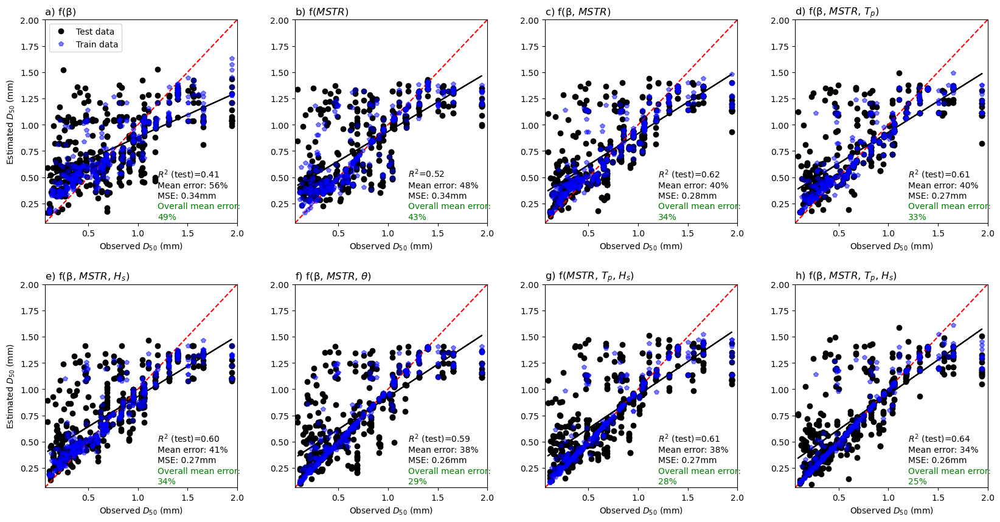

In [15]:
plt.figure(figsize=(20,10))
plt.subplots_adjust(wspace=0.3, hspace=0.3)

plt.subplot(241)
ds_est = model1.predict(X_test1)
plt.plot(y_test1, ds_est, 'ko', label='Test data')
plt.xlim(0.063,2.0); plt.ylim(0.063,2.0)

yl=plt.ylim()
plt.plot(yl,yl,'--r')
plt.xlabel(r'Observed $D_{50}$ (mm)')
plt.ylabel(r'Estimated $D_{50}$ (mm)')
plt.title(r"a) f(β)", loc='left')
r2 = np.min(np.corrcoef(y_test1, ds_est))**2
plt.text(1.2,.5,r'$R^2$ (test)='+str(r2)[:4])

coef = np.polyfit(y_test1, ds_est,1)
poly1d_fn = np.poly1d(coef) 
plt.plot(y_test1, poly1d_fn(y_test1), '-k')
plt.text(1.2,.4, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test1,ds_est)))[:2]))
plt.text(1.2,.3, r'MSE: {}mm'.format(str(Smean[0])[:4]))

ds_est2 = model1.predict(X_train1)
plt.plot(y_train1, ds_est2, 'bp', alpha=0.5, label='Train data')
plt.legend(loc=0)

plt.text(1.2,.2, r'Overall mean error:', color='g')
plt.text(1.2,.1, r'{}%'.format(str(np.mean(prc_err(np.hstack((y_test1,y_train1)),np.hstack((ds_est,ds_est2)))))[:2]), color='g')

plt.subplot(242)
ds_est = model2.predict(X_test2)
plt.plot(y_test2, ds_est, 'ko')
plt.xlim(0.063,2.0); plt.ylim(0.063,2.0)

yl=plt.ylim()
plt.plot(yl,yl,'--r')
plt.xlabel(r'Observed $D_{50}$ (mm)')
# plt.ylabel(r'Estimated $D_{50}$ (mm)')
plt.title(r"b) f($MSTR$)", loc='left')
r2 = np.min(np.corrcoef(y_test2, ds_est))**2
plt.text(1.2,.5,r'$R^2$='+str(r2)[:4])

coef = np.polyfit(y_test2, ds_est,1)
poly1d_fn = np.poly1d(coef) 
plt.plot(y_test2, poly1d_fn(y_test2), '-k')
plt.text(1.2,.4, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test2,ds_est)))[:2]))
plt.text(1.2,.3, r'MSE: {}mm'.format(str(Smean[1])[:4]))

ds_est2 = model2.predict(X_train2)
plt.plot(y_train2, ds_est2, 'bp', alpha=0.5, label='Train data')

plt.text(1.2,.2, r'Overall mean error:', color='g')
plt.text(1.2,.1, r'{}%'.format(str(np.mean(prc_err(np.hstack((y_test2,y_train2)),np.hstack((ds_est,ds_est2)))))[:2]), color='g')

plt.subplot(243)
ds_est = model3.predict(X_test3)
plt.plot(y_test3, ds_est, 'ko')
plt.xlim(0.063,2.0); plt.ylim(0.063,2.0)

yl=plt.ylim()
plt.plot(yl,yl,'--r')
plt.xlabel(r'Observed $D_{50}$ (mm)')
# plt.ylabel(r'Estimated $D_{50}$ (mm)')
plt.title("c) f(β, $MSTR$)", loc='left')
r2 = np.min(np.corrcoef(y_test3, ds_est))**2
plt.text(1.2,.5,r'$R^2$ (test)='+str(r2)[:4])

coef = np.polyfit(y_test3, ds_est,1)
poly1d_fn = np.poly1d(coef) 
plt.plot(y_test3, poly1d_fn(y_test3), '-k')
plt.text(1.2,.4, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test3,ds_est)))[:2]))
plt.text(1.2,.3, r'MSE: {}mm'.format(str(Smean[2])[:4]))

ds_est2 = model3.predict(X_train3)
plt.plot(y_train3, ds_est2, 'bp', alpha=0.5, label='Train data')

plt.text(1.2,.2, r'Overall mean error:', color='g')
plt.text(1.2,.1, r'{}%'.format(str(np.mean(prc_err(np.hstack((y_test3,y_train3)),np.hstack((ds_est,ds_est2)))))[:2]), color='g')

plt.subplot(244)
ds_est = model4.predict(X_test4)
plt.plot(y_test4, ds_est, 'ko')
plt.xlim(0.063,2.0); plt.ylim(0.063,2.0)

yl=plt.ylim()
plt.plot(yl,yl,'--r')
plt.xlabel(r'Observed $D_{50}$ (mm)')
plt.title(r"d) f(β, $MSTR$, $T_p$)", loc='left')
r2 = np.min(np.corrcoef(y_test4, ds_est))**2
plt.text(1.2,.5,r'$R^2$ (test)='+str(r2)[:4])
plt.text(1.2,.4, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test4,ds_est)))[:2]))
plt.text(1.2,.3, r'MSE: {}mm'.format(str(Smean[3])[:4]))

coef = np.polyfit(y_test4, ds_est,1)
poly1d_fn = np.poly1d(coef) 
plt.plot(y_test4, poly1d_fn(y_test4), '-k')

ds_est2 = model4.predict(X_train4)
plt.plot(y_train4, ds_est2, 'bp', alpha=0.5, label='Train data')

plt.text(1.2,.2, r'Overall mean error:', color='g')
plt.text(1.2,.1, r'{}%'.format(str(np.mean(prc_err(np.hstack((y_test4,y_train4)),np.hstack((ds_est,ds_est2)))))[:2]), color='g')


plt.subplot(245)
ds_est = model5.predict(X_test5)
plt.plot(y_test5, ds_est, 'ko')
plt.xlim(0.063,2.0); plt.ylim(0.063,2.0)

yl=plt.ylim()
plt.plot(yl,yl,'--r')
plt.xlabel(r'Observed $D_{50}$ (mm)')
plt.ylabel(r'Estimated $D_{50}$ (mm)')
plt.title(r"e) f(β, $MSTR$, $H_s$)", loc='left')
r2 = np.min(np.corrcoef(y_test5, ds_est))**2
plt.text(1.2,.5,r'$R^2$ (test)='+str(r2)[:4])

coef = np.polyfit(y_test5, ds_est,1)
poly1d_fn = np.poly1d(coef) 
plt.plot(y_test5, poly1d_fn(y_test5), '-k')
plt.text(1.2,.4, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test5,ds_est)))[:2]))
plt.text(1.2,.3, r'MSE: {}mm'.format(str(Smean[4])[:4]))

ds_est2 = model5.predict(X_train5)
plt.plot(y_train5, ds_est2, 'bp', alpha=0.5, label='Train data')

plt.text(1.2,.2, r'Overall mean error:', color='g')
plt.text(1.2,.1, r'{}%'.format(str(np.mean(prc_err(np.hstack((y_test5,y_train5)),np.hstack((ds_est,ds_est2)))))[:2]), color='g')


plt.subplot(246)
ds_est = model6.predict(X_test6)
plt.plot(y_test6, ds_est, 'ko')
plt.xlim(0.063,2.0); plt.ylim(0.063,2.0)

yl=plt.ylim()
plt.plot(yl,yl,'--r')
plt.xlabel(r'Observed $D_{50}$ (mm)')
# plt.ylabel(r'Estimated $D_{50}$ (mm)')
plt.title(r"f) f(β, $MSTR$, $\theta$)", loc='left')
r2 = np.min(np.corrcoef(y_test6, ds_est))**2
plt.text(1.2,.5,r'$R^2$ (test)='+str(r2)[:4])

coef = np.polyfit(y_test6, ds_est,1)
poly1d_fn = np.poly1d(coef) 
plt.plot(y_test6, poly1d_fn(y_test6), '-k')
plt.text(1.2,.4, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test6,ds_est)))[:2]))
plt.text(1.2,.3, r'MSE: {}mm'.format(str(Smean[5])[:4]))

ds_est2 = model6.predict(X_train6)
plt.plot(y_train6, ds_est2, 'bp', alpha=0.5, label='Train data')

plt.text(1.2,.2, r'Overall mean error:', color='g')
plt.text(1.2,.1, r'{}%'.format(str(np.mean(prc_err(np.hstack((y_test6,y_train6)),np.hstack((ds_est,ds_est2)))))[:2]), color='g')

plt.subplot(247)
ds_est = model7.predict(X_test7)
plt.plot(y_test7, ds_est, 'ko')
plt.xlim(0.063,2.0); plt.ylim(0.063,2.0)

yl=plt.ylim()
plt.plot(yl,yl,'--r')
plt.xlabel(r'Observed $D_{50}$ (mm)')
# plt.ylabel(r'Estimated $D_{50}$ (mm)')
plt.title(r"g) f($MSTR$, $T_p$, $H_s$)", loc='left')
r2 = np.min(np.corrcoef(y_test7, ds_est))**2
plt.text(1.2,.5,r'$R^2$ (test)='+str(r2)[:4])

coef = np.polyfit(y_test7, ds_est,1)
poly1d_fn = np.poly1d(coef) 
plt.plot(y_test7, poly1d_fn(y_test7), '-k')
plt.text(1.2,.4, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test7,ds_est)))[:2]))
plt.text(1.2,.3, r'MSE: {}mm'.format(str(Smean[6])[:4]))

ds_est2 = model7.predict(X_train7)
plt.plot(y_train7, ds_est2, 'bp', alpha=0.5, label='Train data')

plt.text(1.2,.2, r'Overall mean error:', color='g')
plt.text(1.2,.1, r'{}%'.format(str(np.mean(prc_err(np.hstack((y_test7,y_train7)),np.hstack((ds_est,ds_est2)))))[:2]), color='g')

plt.subplot(248)
ds_est = model8.predict(X_test8)
plt.plot(y_test8, ds_est, 'ko')
plt.xlim(0.063,2.0); plt.ylim(0.063,2.0)
yl=plt.ylim()
plt.plot(yl,yl,'--r')
plt.xlabel(r'Observed $D_{50}$ (mm)')
# plt.ylabel(r'Estimated $D_{50}$ (mm)')
plt.title(r"h) f(β, $MSTR$, $T_p$, $H_s$)", loc='left')
r2 = np.min(np.corrcoef(y_test8, ds_est))**2
plt.text(1.2,.5,r'$R^2$ (test)='+str(r2)[:4])

coef = np.polyfit(y_test8, ds_est,1)
poly1d_fn = np.poly1d(coef) 
plt.plot(y_test8, poly1d_fn(y_test8), '-k')
plt.text(1.2,.4, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test8,ds_est)))[:2]))
plt.text(1.2,.3, r'MSE: {}mm'.format(str(Smean[7])[:4]))

ds_est2 = model8.predict(X_train8)
plt.plot(y_train8, ds_est2, 'bp', alpha=0.5, label='Train data')

plt.text(1.2,.2, r'Overall mean error:', color='g')
plt.text(1.2,.1, r'{}%'.format(str(np.mean(prc_err(np.hstack((y_test8,y_train8)),np.hstack((ds_est,ds_est2)))))[:2]), color='g')
#

plt.savefig('../model_plots/ThreeRegions_SEUS_EAus_SCA_d50-8models-skill-FINAL2.jpg', dpi=300, bbox_inches='tight')
# plt.savefig('../model_plots/ThreeRegions_SEUS_EAus_SCA_d50-8models-skill-FINAL.jpg', dpi=300, bbox_inches='tight')

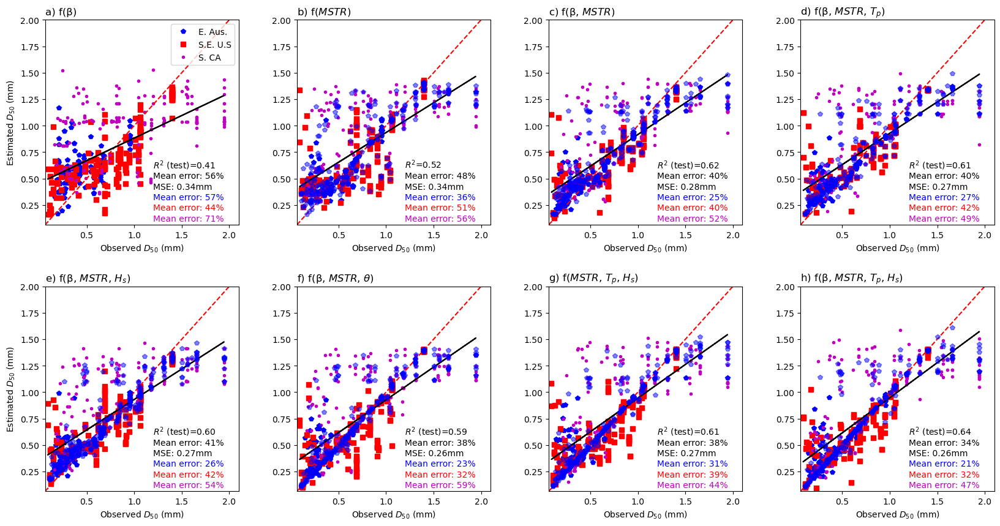

In [16]:
plt.figure(figsize=(20,10))
plt.subplots_adjust(wspace=0.3, hspace=0.3)

C = np.stack((df['code']))
C_train1, C_test1, _, _ = train_test_split(
    C.T, df['d50'], test_size=test_size, random_state=2022
)

plt.subplot(241)
ds_est = model1.predict(X_test1)
plt.plot(y_test1[C_test1==0], ds_est[C_test1==0], 'bp', label='E. Aus.')
plt.plot(y_test1[C_test1==1], ds_est[C_test1==1], 'rs', label='S.E. U.S')
plt.plot(y_test1[C_test1==2], ds_est[C_test1==2], 'm.', label='S. CA')

plt.xlim(0.063,2.1); plt.ylim(0.063,2)
yl=plt.ylim()
plt.plot(yl,yl,'--r')
plt.xlabel(r'Observed $D_{50}$ (mm)')
plt.ylabel(r'Estimated $D_{50}$ (mm)')
plt.title(r"a) f(β)", loc='left')
r2 = np.min(np.corrcoef(y_test1, ds_est))**2
plt.text(1.2,.6,r'$R^2$ (test)='+str(r2)[:4])

coef = np.polyfit(y_test1, ds_est,1)
poly1d_fn = np.poly1d(coef) 
plt.plot(y_test1, poly1d_fn(y_test1), '-k')
plt.text(1.2,.5, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test1,ds_est)))[:2]))
plt.text(1.2,.4, r'MSE: {}mm'.format(str(Smean[0])[:4]))

plt.text(1.2,.3, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test1[C_test1==0],ds_est[C_test1==0])))[:2]), color='b')
plt.text(1.2,.2, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test1[C_test1==1],ds_est[C_test1==1])))[:2]), color='r')
plt.text(1.2,.1, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test1[C_test1==2],ds_est[C_test1==2])))[:2]), color='m')

plt.legend(loc=1)

plt.subplot(242)
ds_est = model2.predict(X_test2)
# plt.plot(y_test2, ds_est, 'ko')
plt.plot(y_test2[C_test1==0], ds_est[C_test1==0], 'bp', label='E. Aus.')
plt.plot(y_test2[C_test1==1], ds_est[C_test1==1], 'rs', label='S.E. U.S')
plt.plot(y_test2[C_test1==2], ds_est[C_test1==2], 'm.', label='S. CA')

plt.xlim(0.063,2.1); plt.ylim(0.063,2)
yl=plt.ylim()
plt.plot(yl,yl,'--r')
plt.xlabel(r'Observed $D_{50}$ (mm)')
# plt.ylabel(r'Estimated $D_{50}$ (mm)')
plt.title(r"b) f($MSTR$)", loc='left')
r2 = np.min(np.corrcoef(y_test2, ds_est))**2
plt.text(1.2,.6,r'$R^2$='+str(r2)[:4])

coef = np.polyfit(y_test2, ds_est,1)
poly1d_fn = np.poly1d(coef) 
plt.plot(y_test2, poly1d_fn(y_test2), '-k')
plt.text(1.2,.5, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test2,ds_est)))[:2]))
plt.text(1.2,.4, r'MSE: {}mm'.format(str(Smean[1])[:4]))

ds_est2 = model2.predict(X_train2)
plt.plot(y_train2, ds_est2, 'bp', alpha=0.5, label='Train data')

plt.text(1.2,.3, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test2[C_test1==0],ds_est[C_test1==0])))[:2]), color='b')
plt.text(1.2,.2, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test2[C_test1==1],ds_est[C_test1==1])))[:2]), color='r')
plt.text(1.2,.1, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test2[C_test1==2],ds_est[C_test1==2])))[:2]), color='m')


plt.subplot(243)
ds_est = model3.predict(X_test3)
plt.plot(y_test3[C_test1==0], ds_est[C_test1==0], 'bp', label='E. Aus.')
plt.plot(y_test3[C_test1==1], ds_est[C_test1==1], 'rs', label='S.E. U.S')
plt.plot(y_test3[C_test1==2], ds_est[C_test1==2], 'm.', label='S. CA')

plt.xlim(0.063,2.1); plt.ylim(0.063,2)
yl=plt.ylim()
plt.plot(yl,yl,'--r')
plt.xlabel(r'Observed $D_{50}$ (mm)')
# plt.ylabel(r'Estimated $D_{50}$ (mm)')
plt.title("c) f(β, $MSTR$)", loc='left')
r2 = np.min(np.corrcoef(y_test3, ds_est))**2
plt.text(1.2,.6,r'$R^2$ (test)='+str(r2)[:4])

coef = np.polyfit(y_test3, ds_est,1)
poly1d_fn = np.poly1d(coef) 
plt.plot(y_test3, poly1d_fn(y_test3), '-k')
plt.text(1.2,.5, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test3,ds_est)))[:2]))
plt.text(1.2,.4, r'MSE: {}mm'.format(str(Smean[2])[:4]))

ds_est2 = model3.predict(X_train3)
plt.plot(y_train3, ds_est2, 'bp', alpha=0.5, label='Train data')

plt.text(1.2,.3, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test3[C_test1==0],ds_est[C_test1==0])))[:2]), color='b')
plt.text(1.2,.2, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test3[C_test1==1],ds_est[C_test1==1])))[:2]), color='r')
plt.text(1.2,.1, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test3[C_test1==2],ds_est[C_test1==2])))[:2]), color='m')

plt.subplot(244)
ds_est = model4.predict(X_test4)
plt.plot(y_test4[C_test1==0], ds_est[C_test1==0], 'bp', label='E. Aus.')
plt.plot(y_test4[C_test1==1], ds_est[C_test1==1], 'rs', label='S.E. U.S')
plt.plot(y_test4[C_test1==2], ds_est[C_test1==2], 'm.', label='S. CA')

plt.xlim(0.063,2.1); plt.ylim(0.063,2)
yl=plt.ylim()
plt.plot(yl,yl,'--r')
plt.xlabel(r'Observed $D_{50}$ (mm)')
plt.title(r"d) f(β, $MSTR$, $T_p$)", loc='left')
r2 = np.min(np.corrcoef(y_test4, ds_est))**2
plt.text(1.2,.6,r'$R^2$ (test)='+str(r2)[:4])
plt.text(1.2,.5, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test4,ds_est)))[:2]))
plt.text(1.2,.4, r'MSE: {}mm'.format(str(Smean[3])[:4]))

coef = np.polyfit(y_test4, ds_est,1)
poly1d_fn = np.poly1d(coef) 
plt.plot(y_test4, poly1d_fn(y_test4), '-k')

ds_est2 = model4.predict(X_train4)
plt.plot(y_train4, ds_est2, 'bp', alpha=0.5, label='Train data')

plt.text(1.2,.3, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test4[C_test1==0],ds_est[C_test1==0])))[:2]), color='b')
plt.text(1.2,.2, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test4[C_test1==1],ds_est[C_test1==1])))[:2]), color='r')
plt.text(1.2,.1, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test4[C_test1==2],ds_est[C_test1==2])))[:2]), color='m')


plt.subplot(245)
ds_est = model5.predict(X_test5)
plt.plot(y_test5[C_test1==0], ds_est[C_test1==0], 'bp', label='E. Aus.')
plt.plot(y_test5[C_test1==1], ds_est[C_test1==1], 'rs', label='S.E. U.S')
plt.plot(y_test5[C_test1==2], ds_est[C_test1==2], 'm.', label='S. CA')

plt.xlim(0.063,2.1); plt.ylim(0.063,2)
yl=plt.ylim()
plt.plot(yl,yl,'--r')
plt.xlabel(r'Observed $D_{50}$ (mm)')
plt.ylabel(r'Estimated $D_{50}$ (mm)')
plt.title(r"e) f(β, $MSTR$, $H_s$)", loc='left')
r2 = np.min(np.corrcoef(y_test5, ds_est))**2
plt.text(1.2,.6,r'$R^2$ (test)='+str(r2)[:4])

coef = np.polyfit(y_test5, ds_est,1)
poly1d_fn = np.poly1d(coef) 
plt.plot(y_test5, poly1d_fn(y_test5), '-k')
plt.text(1.2,.5, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test5,ds_est)))[:2]))
plt.text(1.2,.4, r'MSE: {}mm'.format(str(Smean[4])[:4]))

ds_est2 = model5.predict(X_train5)
plt.plot(y_train5, ds_est2, 'bp', alpha=0.5, label='Train data')

plt.text(1.2,.3, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test5[C_test1==0],ds_est[C_test1==0])))[:2]), color='b')
plt.text(1.2,.2, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test5[C_test1==1],ds_est[C_test1==1])))[:2]), color='r')
plt.text(1.2,.1, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test5[C_test1==2],ds_est[C_test1==2])))[:2]), color='m')


plt.subplot(246)
ds_est = model6.predict(X_test6)
plt.plot(y_test6[C_test1==0], ds_est[C_test1==0], 'bp', label='E. Aus.')
plt.plot(y_test6[C_test1==1], ds_est[C_test1==1], 'rs', label='S.E. U.S')
plt.plot(y_test6[C_test1==2], ds_est[C_test1==2], 'm.', label='S. CA')

plt.xlim(0.063,2.1); plt.ylim(0.063,2)
yl=plt.ylim()
plt.plot(yl,yl,'--r')
plt.xlabel(r'Observed $D_{50}$ (mm)')
# plt.ylabel(r'Estimated $D_{50}$ (mm)')
plt.title(r"f) f(β, $MSTR$, $\theta$)", loc='left')
r2 = np.min(np.corrcoef(y_test6, ds_est))**2
plt.text(1.2,.6,r'$R^2$ (test)='+str(r2)[:4])

coef = np.polyfit(y_test6, ds_est,1)
poly1d_fn = np.poly1d(coef) 
plt.plot(y_test6, poly1d_fn(y_test6), '-k')
plt.text(1.2,.5, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test6,ds_est)))[:2]))
plt.text(1.2,.4, r'MSE: {}mm'.format(str(Smean[5])[:4]))

ds_est2 = model6.predict(X_train6)
plt.plot(y_train6, ds_est2, 'bp', alpha=0.5, label='Train data')

plt.text(1.2,.3, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test6[C_test1==0],ds_est[C_test1==0])))[:2]), color='b')
plt.text(1.2,.2, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test6[C_test1==1],ds_est[C_test1==1])))[:2]), color='r')
plt.text(1.2,.1, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test6[C_test1==2],ds_est[C_test1==2])))[:2]), color='m')

plt.subplot(247)
ds_est = model7.predict(X_test7)
plt.plot(y_test7[C_test1==0], ds_est[C_test1==0], 'bp', label='E. Aus.')
plt.plot(y_test7[C_test1==1], ds_est[C_test1==1], 'rs', label='S.E. U.S')
plt.plot(y_test7[C_test1==2], ds_est[C_test1==2], 'm.', label='S. CA')

plt.xlim(0.063,2.1); plt.ylim(0.063,2)
yl=plt.ylim()
plt.plot(yl,yl,'--r')
plt.xlabel(r'Observed $D_{50}$ (mm)')
# plt.ylabel(r'Estimated $D_{50}$ (mm)')
plt.title(r"g) f($MSTR$, $T_p$, $H_s$)", loc='left')
r2 = np.min(np.corrcoef(y_test7, ds_est))**2
plt.text(1.2,.6,r'$R^2$ (test)='+str(r2)[:4])

coef = np.polyfit(y_test7, ds_est,1)
poly1d_fn = np.poly1d(coef) 
plt.plot(y_test7, poly1d_fn(y_test7), '-k')
plt.text(1.2,.5, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test7,ds_est)))[:2]))
plt.text(1.2,.4, r'MSE: {}mm'.format(str(Smean[6])[:4]))

ds_est2 = model7.predict(X_train7)
plt.plot(y_train7, ds_est2, 'bp', alpha=0.5, label='Train data')

plt.text(1.2,.3, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test7[C_test1==0],ds_est[C_test1==0])))[:2]), color='b')
plt.text(1.2,.2, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test7[C_test1==1],ds_est[C_test1==1])))[:2]), color='r')
plt.text(1.2,.1, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test7[C_test1==2],ds_est[C_test1==2])))[:2]), color='m')

plt.subplot(248)
ds_est = model8.predict(X_test8)
plt.plot(y_test8[C_test1==0], ds_est[C_test1==0], 'bp', label='E. Aus.')
plt.plot(y_test8[C_test1==1], ds_est[C_test1==1], 'rs', label='S.E. U.S')
plt.plot(y_test8[C_test1==2], ds_est[C_test1==2], 'm.', label='S. CA')

plt.xlim(0.063,2.1); plt.ylim(0.063,2)
yl=plt.ylim()
plt.plot(yl,yl,'--r')
plt.xlabel(r'Observed $D_{50}$ (mm)')
# plt.ylabel(r'Estimated $D_{50}$ (mm)')
plt.title(r"h) f(β, $MSTR$, $T_p$, $H_s$)", loc='left')
r2 = np.min(np.corrcoef(y_test8, ds_est))**2
plt.text(1.2,.6,r'$R^2$ (test)='+str(r2)[:4])

coef = np.polyfit(y_test8, ds_est,1)
poly1d_fn = np.poly1d(coef) 
plt.plot(y_test8, poly1d_fn(y_test8), '-k')
plt.text(1.2,.5, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test8,ds_est)))[:2]))
plt.text(1.2,.4, r'MSE: {}mm'.format(str(Smean[7])[:4]))

ds_est2 = model8.predict(X_train8)
plt.plot(y_train8, ds_est2, 'bp', alpha=0.5, label='Train data')

plt.text(1.2,.3, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test8[C_test1==0],ds_est[C_test1==0])))[:2]), color='b')
plt.text(1.2,.2, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test8[C_test1==1],ds_est[C_test1==1])))[:2]), color='r')
plt.text(1.2,.1, r'Mean error: {}%'.format(str(np.mean(prc_err(y_test8[C_test1==2],ds_est[C_test1==2])))[:2]), color='m')

plt.savefig('../model_plots/ThreeRegions_SEUS_EAus_SCA_d50-8models-skill-by-dataset-FINAL2.jpg', dpi=300, bbox_inches='tight')
# plt.savefig('../model_plots/ThreeRegions_SEUS_EAus_SCA_d50-8models-skill-by-dataset-FINAL.jpg', dpi=300, bbox_inches='tight')

In [17]:
X = np.stack((df['beach_slope_average'], df['mstr'], df['tp'], df['hs_mean'],  rand))
ds_est8 = model8.predict(X.T)

X = np.stack((df['beach_slope_average'], df['mstr'], df['tp'], rand))
ds_est4 = model4.predict(X.T)

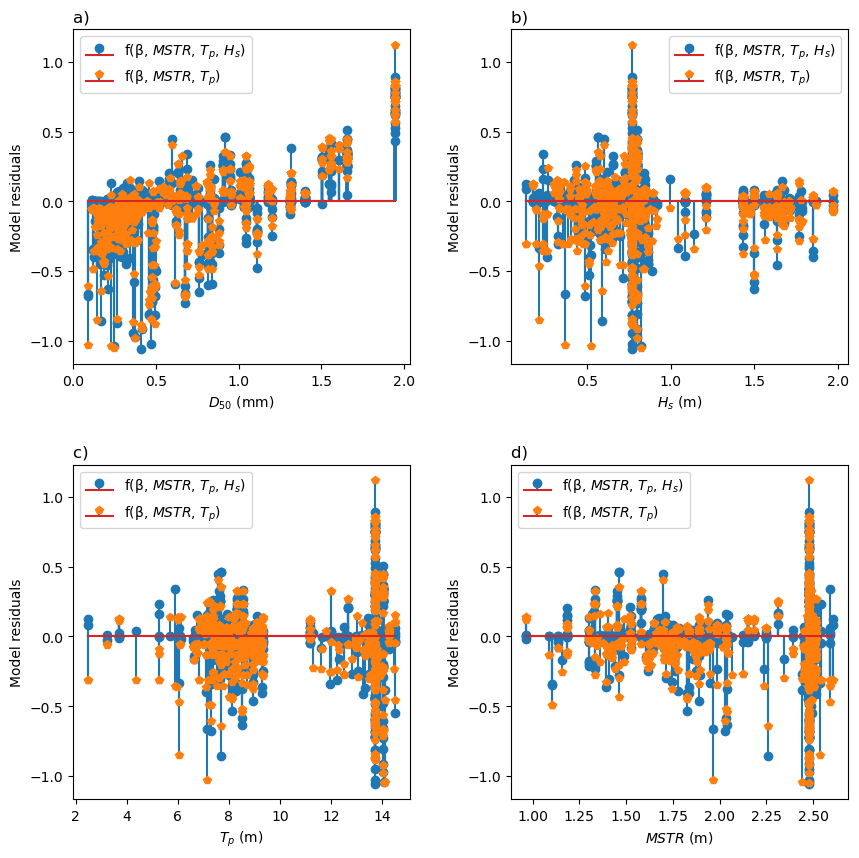

In [18]:
plt.figure(figsize=(10,10))
plt.subplots_adjust(wspace=0.3, hspace=0.3)

plt.subplot(221)
plt.stem(df['d50'], df['d50']-ds_est8,  markerfmt='o', linefmt='-', label=r"f(β, $MSTR$, $T_p$, $H_s$)")
plt.stem(df['d50'], df['d50']-ds_est4,  markerfmt='p', linefmt='-', label = r"f(β, $MSTR$, $T_p$)" )
plt.legend()
plt.ylabel(r'Model residuals')
plt.xlabel(r'$D_{50}$ (mm)')
plt.title(r"a) ", loc='left')

plt.subplot(222)
plt.stem(df['hs_mean'], df['d50']-ds_est8,  markerfmt='o', linefmt='-', label=r"f(β, $MSTR$, $T_p$, $H_s$)")
plt.stem(df['hs_mean'], df['d50']-ds_est4,  markerfmt='p', linefmt='-', label = r"f(β, $MSTR$, $T_p$)" )
plt.legend()
plt.ylabel(r'Model residuals')
plt.xlabel(r'$H_s$ (m)')
plt.title(r"b) ", loc='left')

plt.subplot(223)
plt.stem(df['tp'], df['d50']-ds_est8,  markerfmt='o', linefmt='-', label=r"f(β, $MSTR$, $T_p$, $H_s$)")
plt.stem(df['tp'], df['d50']-ds_est4,  markerfmt='p', linefmt='-', label = r"f(β, $MSTR$, $T_p$)" )
plt.legend()
plt.ylabel(r'Model residuals')
plt.xlabel(r'$T_p$ (m)')
plt.title(r"c) ", loc='left')

plt.subplot(224)
plt.stem(df['mstr'], df['d50']-ds_est8,  markerfmt='o', linefmt='-', label=r"f(β, $MSTR$, $T_p$, $H_s$)")
plt.stem(df['mstr'], df['d50']-ds_est4,  markerfmt='p', linefmt='-', label = r"f(β, $MSTR$, $T_p$)" )
plt.legend()
plt.ylabel(r'Model residuals')
plt.xlabel(r'$MSTR$ (m)')
plt.title(r"d) ", loc='left')

plt.savefig('../model_plots/ThreeRegions_SEUS_EAus_SCA_d50-model8_residuals-skill-FINAL2.jpg', dpi=300, bbox_inches='tight')
# plt.savefig('../model_plots/ThreeRegions_SEUS_EAus_SCA_d50-model8_residuals-skill-FINAL.jpg', dpi=300, bbox_inches='tight')

/home/marda/anaconda3/envs/cgrasp/lib/python3.10/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `loss_` was deprecated in version 1.1 and will be removed in 1.3.
  warnings.warn(msg, category=FutureWarning)
/home/marda/anaconda3/envs/cgrasp/lib/python3.10/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `loss_` was deprecated in version 1.1 and will be removed in 1.3.
  warnings.warn(msg, category=FutureWarning)
/home/marda/anaconda3/envs/cgrasp/lib/python3.10/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `loss_` was deprecated in version 1.1 and will be removed in 1.3.
  warnings.warn(msg, category=FutureWarning)
/home/marda/anaconda3/envs/cgrasp/lib/python3.10/site-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `loss_` was deprecated in version 1.1 and will be removed in 1.3.
  warnings.warn(msg, category=FutureWarning)
/home/marda/anaconda3/envs/cgrasp/lib/python3.10/site-packages/sklea

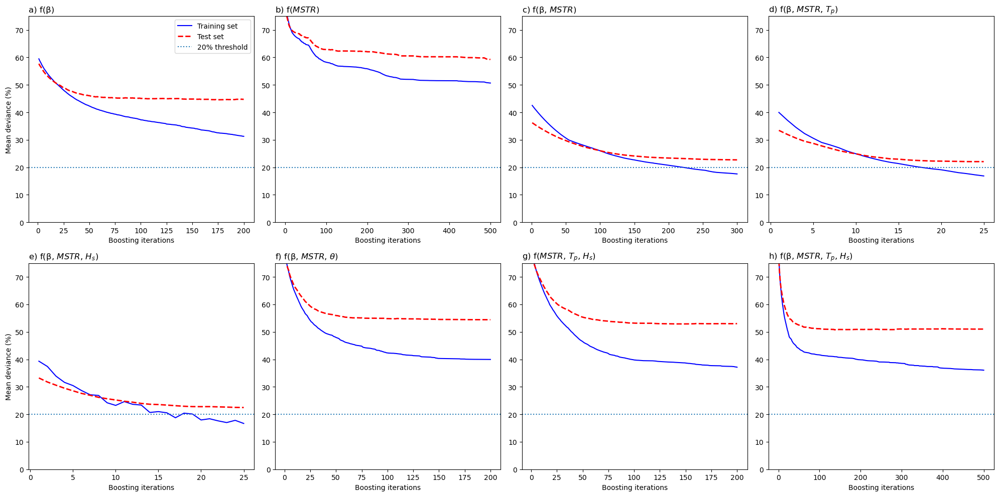

In [19]:
mm = df['d50'].mean()


fig=plt.figure(figsize=(20,10))
plt.subplots_adjust(wspace=0.3, hspace=0.3)

####################
test_score = np.zeros((model1.n_estimators,), dtype=np.float64)
for i, y_pred1 in enumerate(model1.staged_predict(X_test1)):
    test_score[i] = model1.loss_(y_test1, y_pred1)

plt.subplot(2, 4, 1)
plt.title(r"a) f(β)", loc='left')
plt.plot(
    np.arange(model1.n_estimators) + 1,
    100*(np.sqrt(model1.train_score_)/mm),
    "b-",
    label="Training set",
)
plt.plot(
    np.arange(model1.n_estimators) + 1, 100*(np.sqrt(test_score)/mm), "r--", label="Test set", lw=2
)
plt.axhline(20, linestyle=':',label='20% threshold')
# plt.legend(loc="upper right")
plt.xlabel("Boosting iterations")
plt.ylabel("Mean deviance (%)")
plt.ylim(0,75)
plt.legend(loc=0)

###########################
test_score = np.zeros((model2.n_estimators,), dtype=np.float64)
for i, y_pred2 in enumerate(model2.staged_predict(X_test2)):
    test_score[i] = model2.loss_(y_test2, y_pred2)

plt.subplot(2,4, 2)
plt.title(r"b) f($MSTR$)", loc='left')
plt.plot(
    np.arange(model2.n_estimators) + 1,
    100*(np.sqrt(model2.train_score_)/mm),
    "b-",
    label="Training set",
)
plt.plot(
    np.arange(model2.n_estimators) + 1, 100*(np.sqrt(test_score)/mm), "r--", label="Test set", lw=2
)
plt.axhline(20, linestyle=':',label='20% threshold')
# plt.legend(loc="upper right")
plt.xlabel("Boosting iterations")
# plt.ylabel("Deviance (non-dim.)")
plt.ylim(0,75)

#############################
test_score = np.zeros((model3.n_estimators,), dtype=np.float64)
for i, y_pred3 in enumerate(model3.staged_predict(X_test3)):
    test_score[i] = model3.loss_(y_test3, y_pred3)

plt.subplot(2,4, 3)
plt.title("c) f(β, $MSTR$)", loc='left')
plt.plot(
    np.arange(model3.n_estimators) + 1,
    100*(np.sqrt(model3.train_score_)/mm),
    "b-",
    label="Training set",
)
plt.plot(
    np.arange(model3.n_estimators) + 1, 100*(np.sqrt(test_score)/mm), "r--", label="Test set", lw=2
)
plt.axhline(20, linestyle=':',label='20% threshold')
# plt.legend(loc="upper right")
plt.xlabel("Boosting iterations")
# plt.ylabel("Deviance (non-dim.)")
plt.ylim(0,75)

#####################
test_score = np.zeros((model4.n_estimators,), dtype=np.float64)
for i, y_pred4 in enumerate(model4.staged_predict(X_test4)):
    test_score[i] = model4.loss_(y_test4, y_pred4)
    
plt.subplot(2, 4, 4)
plt.title(r"d) f(β, $MSTR$, $T_p$) ", loc='left')
plt.plot(
    np.arange(model4.n_estimators) + 1,
    100*(np.sqrt(model4.train_score_)/mm),
    "b-",
    label="Training set",
)
plt.plot(
    np.arange(model4.n_estimators) + 1, 100*(np.sqrt(test_score)/mm), "r--", label="Test set", lw=2
)
plt.axhline(20, linestyle=':',label='20% threshold')
plt.xlabel("Boosting iterations")
# plt.ylabel("Deviance (non-dim.)")
plt.ylim(0,75)

#####################
test_score = np.zeros((model5.n_estimators,), dtype=np.float64)
for i, y_pred5 in enumerate(model5.staged_predict(X_test5)):
    test_score[i] = model5.loss_(y_test5, y_pred5)
    
plt.subplot(2,4, 5)
plt.title(r"e) f(β, $MSTR$, $H_s$) ", loc='left')
plt.plot(
    np.arange(model5.n_estimators) + 1,
    100*(np.sqrt(model5.train_score_)/mm),
    "b-",
    label="Training set",
)
plt.plot(
    np.arange(model5.n_estimators) + 1, 100*(np.sqrt(test_score)/mm), "r--", label="Test set", lw=2
)
plt.axhline(20, linestyle=':',label='20% threshold')
# plt.legend(loc="upper right")
plt.xlabel("Boosting iterations")
plt.ylabel("Mean deviance (%)")
plt.ylim(0,75)

#####################
test_score = np.zeros((model6.n_estimators,), dtype=np.float64)
for i, y_pred6 in enumerate(model6.staged_predict(X_test6)):
    test_score[i] = model6.loss_(y_test6, y_pred6)
    
plt.subplot(2, 4, 6)
plt.title(r"f) f(β, $MSTR$, $\theta$) ", loc='left')
plt.plot(
    np.arange(model6.n_estimators) + 1,
    100*(np.sqrt(model6.train_score_)/mm),
    "b-",
    label="Training set",
)
plt.plot(
    np.arange(model6.n_estimators) + 1, 100*(np.sqrt(test_score)/mm), "r--", label="Test set", lw=2
)
plt.axhline(20, linestyle=':',label='20% threshold')
# plt.legend(loc="upper right")
plt.xlabel("Boosting iterations")
# plt.ylabel("Deviance (non-dim.)")
plt.ylim(0,75)

#####################
test_score = np.zeros((model7.n_estimators,), dtype=np.float64)
for i, y_pred7 in enumerate(model7.staged_predict(X_test7)):
    test_score[i] = model7.loss_(y_test7, y_pred7)
    
plt.subplot(2, 4, 7)
plt.title(r"g) f($MSTR$, $T_p$, $H_s$) ", loc='left')
plt.plot(
    np.arange(model7.n_estimators) + 1,
    100*(np.sqrt(model7.train_score_)/mm),
    "b-",
    label="Training set",
)
plt.plot(
    np.arange(model7.n_estimators) + 1, 100*(np.sqrt(test_score)/mm), "r--", label="Test set", lw=2
)
plt.axhline(20, linestyle=':',label='20% threshold')
# plt.legend(loc="upper right")
plt.xlabel("Boosting iterations")
# plt.ylabel("Deviance (non-dim.)")
plt.ylim(0,75)

#####################
test_score = np.zeros((model8.n_estimators,), dtype=np.float64)
for i, y_pred8 in enumerate(model8.staged_predict(X_test8)):
    test_score[i] = model8.loss_(y_test8, y_pred8)
    
plt.subplot(2, 4, 8)
plt.title(r"h) f(β, $MSTR$, $T_p$, $H_s$) ", loc='left')
plt.plot(
    np.arange(model8.n_estimators) + 1,
    100*(np.sqrt(model8.train_score_)/mm),
    "b-",
    label="Training set",
)
plt.plot(
    np.arange(model8.n_estimators) + 1, 100*(np.sqrt(test_score)/mm), "r--", label="Test set", lw=2
)
plt.axhline(20, linestyle=':',label='20% threshold')
# plt.legend(loc="upper right")
plt.xlabel("Boosting iterations")
# plt.ylabel("Deviance (non-dim.)")
plt.ylim(0,75)

fig.tight_layout()

plt.savefig('../model_plots/ThreeRegions_SEUS_EAus_SCA_d50-8models-training-FINAL2.jpg', dpi=300, bbox_inches='tight')
# plt.savefig('../model_plots/ThreeRegions_SEUS_EAus_SCA_d50-8models-training-FINAL.jpg', dpi=300, bbox_inches='tight')

[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=0.75; total time=   0.7s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=25, subsample=1.0; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.25; total time=   0.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.5; total time=   0.9s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=0.75; total time=   1.2s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=50, subsample=1.0; total time=   1.6s
[CV] END learning_rate=0.1, loss=huber, max_depth=11, min_samples_split=5, n_estimators=100, subsample=0.5; total 

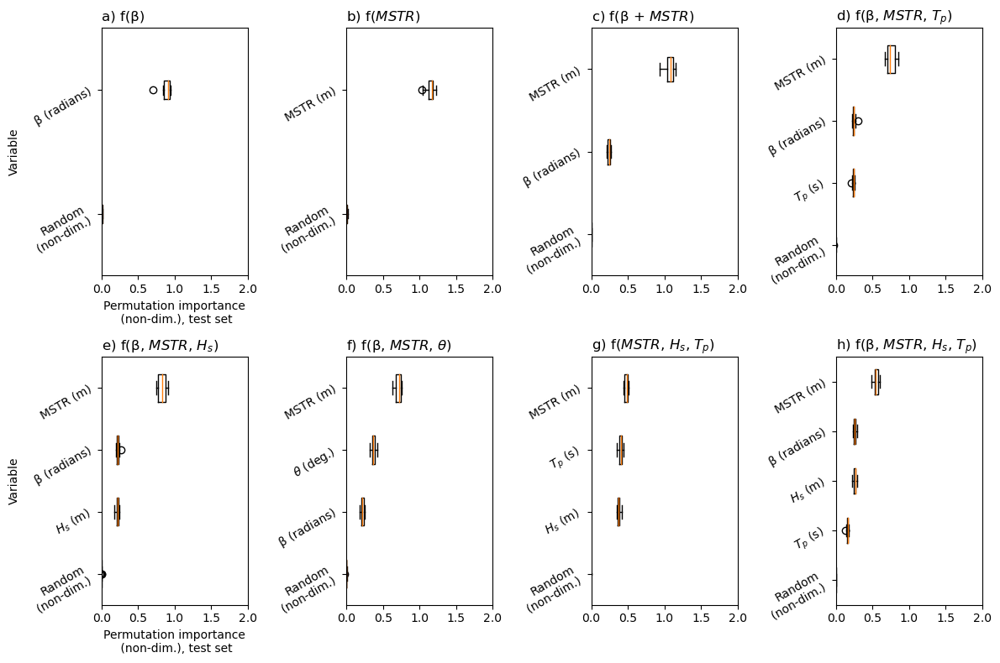

In [20]:

fig=plt.figure(figsize=(12,8))
plt.subplots_adjust(wspace=0.4, hspace=0.4)

########################
result = permutation_importance(
    model1, X_test1, y_test1, n_repeats=10, random_state=42, n_jobs=2
)
sorted_idx = result.importances_mean.argsort()
ax=plt.subplot(241)
plt.boxplot(
    result.importances[sorted_idx].T,
    vert=False,
    labels=np.array(feature_names1)[sorted_idx],
)

plt.xlim(0,2)
plt.title("a) f(β) ", loc='left')
plt.xlabel("Permutation importance\n (non-dim.), test set")
plt.ylabel("Variable")
plt.setp(ax.get_yticklabels (), rotation=30)

#########################
result = permutation_importance(
    model2, X_test2, y_test2, n_repeats=10, random_state=42, n_jobs=2
)
sorted_idx = result.importances_mean.argsort()
ax=plt.subplot(242)
plt.boxplot(
    result.importances[sorted_idx].T,
    vert=False,
    labels=np.array(feature_names2)[sorted_idx],
)

plt.xlim(0,2)
plt.title("b) f($MSTR$) ", loc='left')
# plt.xlabel("Permutation importance (non-dim.), test set")
# plt.ylabel("Variable")
plt.setp(ax.get_yticklabels (), rotation=30)

#############################
result = permutation_importance(
    model3, X_test3, y_test3, n_repeats=10, random_state=42, n_jobs=2
)
sorted_idx = result.importances_mean.argsort()
ax=plt.subplot(243)
plt.boxplot(
    result.importances[sorted_idx].T,
    vert=False,
    labels=np.array(feature_names3)[sorted_idx],
)

plt.xlim(0,2)
plt.title("c) f(β + $MSTR$) ", loc='left')
# plt.xlabel("Permutation importance (non-dim.), test set")
# plt.ylabel("Variable")
plt.setp(ax.get_yticklabels (), rotation=30)

############################
result = permutation_importance(
    model4, X_test4, y_test4, n_repeats=10, random_state=42, n_jobs=2
)
sorted_idx = result.importances_mean.argsort()
ax=plt.subplot(244)
plt.boxplot(
    result.importances[sorted_idx].T,
    vert=False,
    labels=np.array(feature_names4)[sorted_idx],
)
plt.xlim(0,2)
plt.title(r"d) f(β, $MSTR$, $T_p$)", loc='left')
# plt.xlabel("Permutation importance (non-dim.), test set")
# plt.ylabel("Variable")
plt.setp(ax.get_yticklabels (), rotation=30)

############################
result = permutation_importance(
    model5, X_test5, y_test5, n_repeats=10, random_state=42, n_jobs=2
)
sorted_idx = result.importances_mean.argsort()
ax=plt.subplot(245)
plt.boxplot(
    result.importances[sorted_idx].T,
    vert=False,
    labels=np.array(feature_names5)[sorted_idx],
)
plt.xlim(0,2)
plt.title(r"e) f(β, $MSTR$, $H_s$)", loc='left')
plt.xlabel("Permutation importance\n (non-dim.), test set")
plt.ylabel("Variable")
plt.setp(ax.get_yticklabels (), rotation=30)

##################################
result = permutation_importance(
    model6, X_test6, y_test6, n_repeats=10, random_state=42, n_jobs=2
)
sorted_idx = result.importances_mean.argsort()
ax=plt.subplot(246)
plt.boxplot(
    result.importances[sorted_idx].T,
    vert=False,
    labels=np.array(feature_names6)[sorted_idx],
)
plt.xlim(0,2)
plt.title(r"f) f(β, $MSTR$, $\theta$)", loc='left')
# plt.xlabel("Permutation importance (non-dim.), test set")
# plt.ylabel("Variable")
plt.setp(ax.get_yticklabels (), rotation=30)

##################################
result = permutation_importance(
    model7, X_test7, y_test7, n_repeats=10, random_state=42, n_jobs=2
)
sorted_idx = result.importances_mean.argsort()
ax=plt.subplot(247)
plt.boxplot(
    result.importances[sorted_idx].T,
    vert=False,
    labels=np.array(feature_names7)[sorted_idx],
)
plt.xlim(0,2)
plt.title(r"g) f($MSTR$, $H_s$, $T_p$)", loc='left')
# plt.xlabel("Permutation importance (non-dim.), test set")
# plt.ylabel("Variable")
plt.setp(ax.get_yticklabels (), rotation=30)

##################################
result = permutation_importance(
    model8, X_test8, y_test8, n_repeats=10, random_state=42, n_jobs=2
)
sorted_idx = result.importances_mean.argsort()
ax=plt.subplot(248)
plt.boxplot(
    result.importances[sorted_idx].T,
    vert=False,
    labels=np.array(feature_names8)[sorted_idx],
)
plt.setp(ax.get_yticklabels (), rotation=30)
plt.xlim(0,2)
plt.title(r"h) f(β, $MSTR$, $H_s$, $T_p$)", loc='left')
# plt.xlabel("Permutation importance (non-dim.), test set")
# plt.ylabel("Variable")

fig.tight_layout()

plt.savefig('../model_plots/ThreeRegions_SEUS_EAus_SCA_d50-8models-featimps-FINAL2.jpg', dpi=300, bbox_inches='tight')
# plt.savefig('../model_plots/ThreeRegions_SEUS_EAus_SCA_d50-8models-featimps-FINAL.jpg', dpi=300, bbox_inches='tight')

In [21]:
# np.save('../model_out/dataset_ThreeRegions_SEUS_EAus_SCA_coast_model1_FINAL.npy', model1out, allow_pickle=True)
# np.save('../model_out/dataset_ThreeRegions_SEUS_EAus_SCA_coast_model2_FINAL.npy', model2out, allow_pickle=True)
# np.save('../model_out/dataset_ThreeRegions_SEUS_EAus_SCA_coast_model3_FINAL.npy', model3out, allow_pickle=True)
# np.save('../model_out/dataset_ThreeRegions_SEUS_EAus_SCA_coast_model4_FINAL.npy', model4out, allow_pickle=True)
# np.save('../model_out/dataset_ThreeRegions_SEUS_EAus_SCA_coast_model5_FINAL.npy', model5out, allow_pickle=True)
# np.save('../model_out/dataset_ThreeRegions_SEUS_EAus_SCA_coast_model6_FINAL.npy', model6out, allow_pickle=True)
# np.save('../model_out/dataset_ThreeRegions_SEUS_EAus_SCA_coast_model7_FINAL.npy', model7out, allow_pickle=True)
# np.save('../model_out/dataset_ThreeRegions_SEUS_EAus_SCA_coast_model8_FINAL.npy', model8out, allow_pickle=True)


In [21]:
np.save('../model_out/dataset_ThreeRegions_SEUS_EAus_SCA_coast_model1_FINAL2.npy', model1out, allow_pickle=True)
np.save('../model_out/dataset_ThreeRegions_SEUS_EAus_SCA_coast_model2_FINAL2.npy', model2out, allow_pickle=True)
np.save('../model_out/dataset_ThreeRegions_SEUS_EAus_SCA_coast_model3_FINAL2.npy', model3out, allow_pickle=True)
np.save('../model_out/dataset_ThreeRegions_SEUS_EAus_SCA_coast_model4_FINAL2.npy', model4out, allow_pickle=True)
np.save('../model_out/dataset_ThreeRegions_SEUS_EAus_SCA_coast_model5_FINAL2.npy', model5out, allow_pickle=True)
np.save('../model_out/dataset_ThreeRegions_SEUS_EAus_SCA_coast_model6_FINAL2.npy', model6out, allow_pickle=True)
np.save('../model_out/dataset_ThreeRegions_SEUS_EAus_SCA_coast_model7_FINAL2.npy', model7out, allow_pickle=True)
np.save('../model_out/dataset_ThreeRegions_SEUS_EAus_SCA_coast_model8_FINAL2.npy', model8out, allow_pickle=True)


In [22]:
[model1.get_params()['learning_rate'], model2.get_params()['learning_rate'], model3.get_params()['learning_rate'],
 model4.get_params()['learning_rate'], model5.get_params()['learning_rate'], model6.get_params()['learning_rate'],
 model7.get_params()['learning_rate'], model8.get_params()['learning_rate']]

[0.05, 0.05, 0.01, 0.1, 0.1, 0.075, 0.05, 0.1]

In [23]:
[model1.get_params()['max_depth'], model2.get_params()['max_depth'], model3.get_params()['max_depth'],
 model4.get_params()['max_depth'], model5.get_params()['max_depth'], model6.get_params()['max_depth'],
 model7.get_params()['max_depth'], model8.get_params()['max_depth']]

[3, 3, 5, 5, 5, 5, 7, 5]

In [24]:
[model1.get_params()['n_estimators'], model2.get_params()['n_estimators'], model3.get_params()['n_estimators'],
 model4.get_params()['n_estimators'], model5.get_params()['n_estimators'], model6.get_params()['n_estimators'],
 model7.get_params()['n_estimators'], model8.get_params()['n_estimators']]

[200, 500, 300, 25, 25, 200, 200, 500]

In [25]:
[model1.get_params()['subsample'], model2.get_params()['subsample'], model3.get_params()['subsample'],
 model4.get_params()['subsample'], model5.get_params()['subsample'], model6.get_params()['subsample'],
 model7.get_params()['subsample'], model8.get_params()['subsample']]

[1.0, 1.0, 1.0, 1.0, 0.75, 1.0, 1.0, 1.0]

In [26]:
[model1.get_params()['min_samples_split'], model2.get_params()['min_samples_split'], model3.get_params()['min_samples_split'],
 model4.get_params()['min_samples_split'], model5.get_params()['min_samples_split'], model6.get_params()['min_samples_split'],
 model7.get_params()['min_samples_split'], model8.get_params()['min_samples_split']]

[3, 3, 11, 7, 7, 5, 11, 9]

In [27]:
[model1.get_params()['loss'], model2.get_params()['loss'], model3.get_params()['loss'],
 model4.get_params()['loss'], model5.get_params()['loss'], model6.get_params()['loss'],
 model7.get_params()['loss'], model8.get_params()['loss']]

['squared_error',
 'absolute_error',
 'huber',
 'huber',
 'huber',
 'absolute_error',
 'absolute_error',
 'absolute_error']

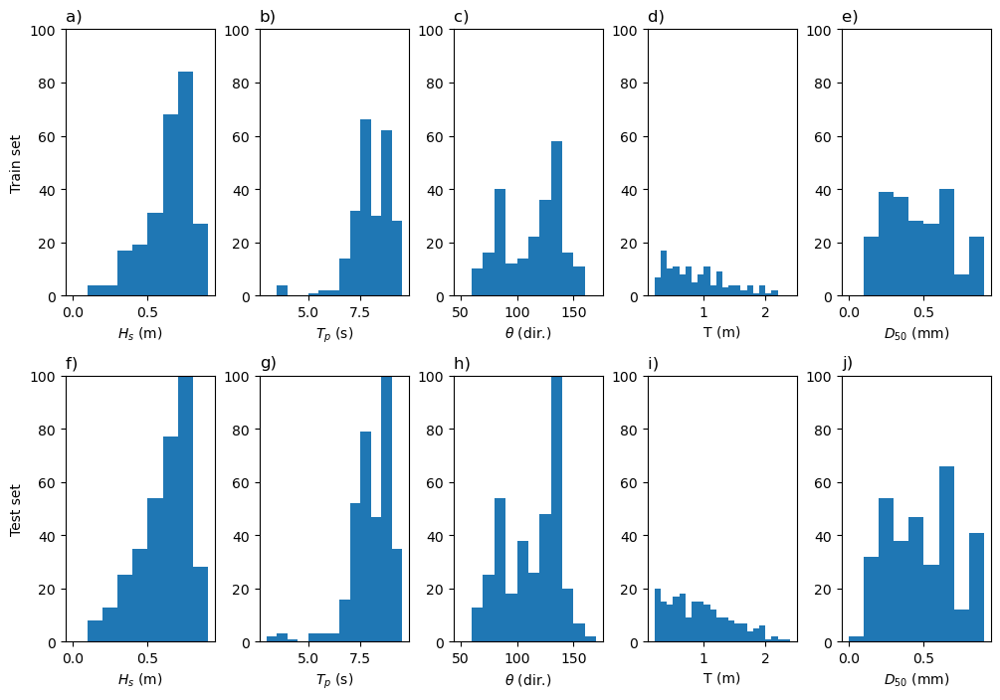

In [28]:
testlim = 100
trainlim = 100

fig = plt.figure(figsize=(12,8))
plt.subplots_adjust(wspace=0.3, hspace=0.3)


plt.subplot(2,5,1)
plt.hist(X_train5[:,2], bins=np.arange(0,1,.1))
plt.ylim(0,trainlim); plt.ylabel('Train set'); plt.xlabel(r'$H_s$ (m)')
plt.title(r'a) ', loc='left')

plt.subplot(2,5,2)
plt.hist(X_train4[:,2], bins=np.arange(3,10,.5))
plt.ylim(0,trainlim); plt.xlabel(r'$T_p$ (s)')
plt.title(r'b)', loc='left')

plt.subplot(2,5,3)
plt.hist(X_train6[:,2], bins=np.arange(50,180,10))
plt.ylim(0,trainlim); plt.xlabel(r'$\theta$ (dir.)')
plt.title(r'c) ', loc='left')

plt.subplot(2,5,4)
plt.hist(X_train4[:,3], bins=np.arange(0.2,2.5,.1))
plt.ylim(0,trainlim); plt.xlabel('T (m)')
plt.title(r'd) ', loc='left')

plt.subplot(2,5,5)
plt.hist(y_train4, bins=np.arange(0,1,.1))
plt.ylim(0,trainlim); plt.xlabel(r'$D_{50}$ (mm)')
plt.title(r'e) ', loc='left')

plt.subplot(2,5,6)
plt.hist(X_test5[:,2], bins=np.arange(0,1,.1))
plt.ylim(0,testlim); plt.ylabel('Test set'); plt.xlabel(r'$H_s$ (m)')
plt.title(r'f) ', loc='left')

plt.subplot(2,5,7)
plt.hist(X_test4[:,2], bins=np.arange(3,10,.5))
plt.ylim(0,testlim); plt.xlabel(r'$T_p$ (s)')
plt.title(r'g)', loc='left')

plt.subplot(2,5,8)
plt.hist(X_test6[:,2], bins=np.arange(50,180,10))
plt.ylim(0,testlim); plt.xlabel(r'$\theta$ (dir.)')
plt.title(r'h) ', loc='left')

plt.subplot(2,5,9)
plt.hist(X_test4[:,3], bins=np.arange(0.2,2.5,.1))
plt.ylim(0,testlim); plt.xlabel('T (m)')
plt.title(r'i) ', loc='left')

plt.subplot(2,5,10)
plt.hist(y_test4, bins=np.arange(0,1,.1))
plt.ylim(0,testlim); plt.xlabel('$D_{50}$ (mm)')
plt.title(r'j) ', loc='left')

plt.savefig('../data_plots/ThreeRegions_SEUS_EAus_SCA_d50-test_train_dists-FINAL2.jpg', dpi=300, bbox_inches='tight')
# plt.savefig('../data_plots/ThreeRegions_SEUS_EAus_SCA_d50-test_train_dists-FINAL.jpg', dpi=300, bbox_inches='tight')